In [27]:
import netCDF4 as nc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import glob
import gc
from datetime import datetime, timedelta
import warnings
from scipy import stats as scipy_stats
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from statsmodels.stats.outliers_influence import variance_inflation_factor
import os
import numpy.ma as ma
warnings.filterwarnings('ignore')

class WeatherEDA:
    """Class for weather data EDA"""
    
    def __init__(self, data_directory="."):
        self.data_dir = data_directory
        self.file_paths = {}
        self.variable_mapping = {
            'bi': 'burning_index_g',
            'etr': 'potential_evapotranspiration', 
            'fm1000': 'dead_fuel_moisture_1000hr',
            'fm100': 'dead_fuel_moisture_100hr',
            'pet': 'potential_evapotranspiration',
            'pr': 'precipitation_amount',
            'rmax': 'relative_humidity',
            'rmin': 'relative_humidity', 
            'sph': 'specific_humidity',
            'srad': 'surface_downwelling_shortwave_flux_in_air',
            'th': 'wind_from_direction',
            'tmmn': 'air_temperature',
            'tmmx': 'air_temperature',
            'vpd': 'mean_vapor_pressure_deficit',
            'vs': 'wind_speed'
        }
        self.variable_descriptions = {
            'bi': 'Fire danger index',
            'etr': 'Reference evapotranspiration',
            'fm1000': 'Large fuel moisture content', 
            'fm100': 'Medium fuel moisture content',
            'pet': 'Potential evapotranspiration',
            'pr': 'Daily precipitation',
            'rmax': 'Maximum relative humidity',
            'rmin': 'Minimum relative humidity',
            'sph': 'Atmospheric moisture content',
            'srad': 'Solar radiation flux',
            'th': 'Wind direction',
            'tmmn': 'Minimum daily temperature',
            'tmmx': 'Maximum daily temperature', 
            'vpd': 'Vapor pressure deficit',
            'vs': 'Wind speed'
        }
        self._scan_files()
    
    def _scan_files(self):
        """Scan dir for available files"""
        pattern = f"{self.data_dir}/Weather_data_*_2003.nc"
        files = sorted(glob.glob(pattern))
        
        for file in files:
            filename = file.split('/')[-1].split('\\')[-1]
            var_type = filename.replace('Weather_data_', '').replace('_2003.nc', '')
            
            if var_type != 'metdata_elevationdata':
                self.file_paths[var_type] = file
                
        print(f"Found {len(self.file_paths)} weather variables")
    
    def open_dataset(self, var_type):
        """open dataset"""
        if var_type not in self.file_paths:
            raise ValueError(f"Variable {var_type} not available")
        return nc.Dataset(self.file_paths[var_type], 'r')
    
    def get_dataset_info(self, var_type):
        """dataset information"""
        with self.open_dataset(var_type) as ds:
            dimensions = {}
            for dim_name, dim in ds.dimensions.items():
                dimensions[dim_name] = len(dim)
            
            info = {
                'variable': var_type,
                'description': self.variable_descriptions.get(var_type, 'Unknown'),
                'dimensions': dimensions,
                'variables': list(ds.variables.keys()),
                'global_attributes': dict(ds.__dict__),
                'time_range': None,
                'spatial_extent': None
            }
            
            if 'day' in ds.variables:
                time_var = ds.variables['day']
                time_data = time_var[:]  
                info['time_range'] = {
                    'start': datetime(1900, 1, 1) + timedelta(days=int(time_data[0])),
                    'end': datetime(1900, 1, 1) + timedelta(days=int(time_data[-1])),
                    'length': len(time_data)
                }
            
            if 'lat' in ds.variables and 'lon' in ds.variables:
                lat_data = ds.variables['lat'][:]  
                lon_data = ds.variables['lon'][:]  
                info['spatial_extent'] = {
                    'lat_range': (float(lat_data.min()), float(lat_data.max())),
                    'lon_range': (float(lon_data.min()), float(lon_data.max())),
                    'grid_size': (len(lat_data), len(lon_data))
                }
            
            return info
    
    def print_dataset_summary(self):
        """print summary"""
        print("="*60)
        print("Weather Dataset Summary")
        print("="*60)
        
        for var_type in self.file_paths.keys():
            info = self.get_dataset_info(var_type)
            print(f"\n{var_type.upper()}: {info['description']}")
            print(f"   Dimensions: {info['dimensions']}")
            if info['time_range']:
                print(f"   Time: {info['time_range']['start'].strftime('%Y-%m-%d')} to {info['time_range']['end'].strftime('%Y-%m-%d')}")
            if info['spatial_extent']:
                print(f"   Spatial: {info['spatial_extent']['grid_size']} grid points")
                print(f"   Lat: {info['spatial_extent']['lat_range'][0]:.2f} to {info['spatial_extent']['lat_range'][1]:.2f}")
                print(f"   Lon: {info['spatial_extent']['lon_range'][0]:.2f} to {info['spatial_extent']['lon_range'][1]:.2f}")
    
    def sample_data(self, var_type, n_points=1000, random_seed=42):
        """sample data points for analysis"""
        np.random.seed(random_seed)
        
        with self.open_dataset(var_type) as ds:
            data_vars = [v for v in ds.variables.keys() 
                        if v not in ['lat', 'lon', 'day', 'crs']]
            
            if not data_vars:
                raise ValueError(f"No data variables found in {var_type}")
            
            main_var = data_vars[0]
            data = ds.variables[main_var][:]
            
            # handle diff shapes
            if data.ndim == 3:  # time, lat, lon
                time_idx = np.random.choice(data.shape[0], min(50, data.shape[0]), replace=False)
                lat_idx = np.random.choice(data.shape[1], min(20, data.shape[1]), replace=False)
                lon_idx = np.random.choice(data.shape[2], min(20, data.shape[2]), replace=False)
                
                sample = data[np.ix_(time_idx, lat_idx, lon_idx)]
                sample = sample.flatten()
            else:
                sample = data.flatten()
    
            sample = sample[~np.isnan(sample) & ~np.isinf(sample)]
            
            if len(sample) > n_points:
                sample = np.random.choice(sample, n_points, replace=False)
            
            return sample
    
    def basic_statistics(self, var_type):
        """calculate basic stats"""
        sample = self.sample_data(var_type)
        
        statistics = {
            'count': len(sample),
            'mean': np.mean(sample),
            'std': np.std(sample),
            'min': np.min(sample),
            'max': np.max(sample),
            'median': np.median(sample),
            'q25': np.percentile(sample, 25),
            'q75': np.percentile(sample, 75),
            'skewness': scipy_stats.skew(sample),
            'kurtosis': scipy_stats.kurtosis(sample),
            'missing_pct': 0  
        }
        
        return statistics
    
    def seasonal_analysis(self, var_type, year=2003):
        """seasonal patterns"""
        with self.open_dataset(var_type) as ds:
            data_vars = [v for v in ds.variables.keys() 
                        if v not in ['lat', 'lon', 'day', 'crs']]
            main_var = data_vars[0]
            
            time_data = ds.variables['day'][:]
            var_data = ds.variables[main_var][:]
            dates = [datetime(1900, 1, 1) + timedelta(days=int(d)) for d in time_data]
            
            if var_data.ndim == 3:
                daily_means = np.nanmean(var_data, axis=(1, 2))
            else:
                daily_means = var_data
            
            df = pd.DataFrame({
                'date': dates,
                'value': daily_means
            })
            df['month'] = df['date'].dt.month
            df['day_of_year'] = df['date'].dt.dayofyear
            
            monthly_stats = df.groupby('month')['value'].agg(['mean', 'std', 'min', 'max'])
    
            fig, axes = plt.subplots(2, 2, figsize=(15, 10))
            fig.suptitle(f'Seasonal Analysis: {var_type.upper()}', fontsize=16)
            
            axes[0,0].plot(df['date'], df['value'], alpha=0.7)
            axes[0,0].set_title('Full Year Time Series')
            axes[0,0].set_xlabel('Date')
            axes[0,0].set_ylabel('Value')
            axes[0,0].grid(True, alpha=0.3)
            
            monthly_data = [df[df['month'] == m]['value'].values for m in range(1, 13)]
            axes[0,1].boxplot(monthly_data, labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                                                  'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
            axes[0,1].set_title('Monthly Distribution')
            axes[0,1].set_ylabel('Value')
            axes[0,1].grid(True, alpha=0.3)
            
            axes[1,0].plot(range(1, 13), monthly_stats['mean'], marker='o', linewidth=2)
            axes[1,0].fill_between(range(1, 13), 
                                 monthly_stats['mean'] - monthly_stats['std'],
                                 monthly_stats['mean'] + monthly_stats['std'], alpha=0.3)
            axes[1,0].set_title('Monthly Means ± Std')
            axes[1,0].set_xlabel('Month')
            axes[1,0].set_ylabel('Value')
            axes[1,0].set_xticks(range(1, 13))
            axes[1,0].grid(True, alpha=0.3)
            
            daily_avg = df.groupby('day_of_year')['value'].mean()
            axes[1,1].plot(daily_avg.index, daily_avg.values)
            axes[1,1].set_title('Average by Day of Year')
            axes[1,1].set_xlabel('Day of Year')
            axes[1,1].set_ylabel('Value')
            axes[1,1].grid(True, alpha=0.3)
            
            plt.tight_layout()
            return fig, monthly_stats


    
    
    def plot_spatial_map(self, var_type, date=None, agg_method='mean', cmap='viridis', figsize=(12, 8)):
        """
        weather variable spatial mapping with comprehensive data handling.
        
        Parameters:
        - var_type (str): Variable to plot ('pr', 'tmmx', 'tmmn', 'fm100', 'bi', 'etr').
        - date (str, optional): Specific date in 'YYYY-MM-DD' format. If None, aggregates over time.
        - agg_method (str): Aggregation method if date is None ('mean', 'sum', 'max', 'min').
        - cmap (str): Matplotlib colormap name (overridden for specific variables).
        - figsize (tuple): Figure size.
        
        Returns:
        - fig: Matplotlib figure object.
        """
        with self.open_dataset(var_type) as ds:
            data_vars = [v for v in ds.variables.keys() if v not in ['lat', 'lon', 'day', 'crs']]
            if not data_vars:
                raise ValueError(f"No data variables found in {var_type}")
            main_var = data_vars[0]
            var_data = ds.variables[main_var]
            
            print(f"Analyzing {var_type} ({main_var})")
            
            lat = ds.variables['lat'][:]
            lon = ds.variables['lon'][:]
            print(f"Grid: {len(lat)} x {len(lon)} points")
            print(f"Lat range: {lat.min():.2f} to {lat.max():.2f}")  
            print(f"Lon range: {lon.min():.2f} to {lon.max():.2f}")
            
            # metadata
            units = getattr(var_data, 'units', 'unknown')
            scale_factor = getattr(var_data, 'scale_factor', 1.0)
            add_offset = getattr(var_data, 'add_offset', 0.0)
            fill_value = getattr(var_data, '_FillValue', None)
            missing_value = getattr(var_data, 'missing_value', None)
            
            print(f"Metadata - Units: {units}, Scale: {scale_factor}, Offset: {add_offset}")
            print(f"Fill/Missing values: {fill_value}/{missing_value}")
            
            data = var_data[:]
            print(f"Raw data shape: {data.shape}")
            print(f"Raw data range: {np.nanmin(data):.3f} to {np.nanmax(data):.3f}")
            
            # handle fill values and missing values FIRST 
            if fill_value is not None:
                data = np.ma.masked_equal(data, fill_value)
                print(f"Masked fill value: {fill_value}")
            if missing_value is not None and missing_value != fill_value:
                data = np.ma.masked_equal(data, missing_value)
                print(f"Masked missing value: {missing_value}")
            
            if scale_factor != 1.0 or add_offset != 0.0:
                if var_type in ['tmmx', 'tmmn'] and 200 < np.nanmin(data) < 400 and 200 < np.nanmax(data) < 400:
                    print(f"Raw temperature data already in reasonable Kelvin range - skipping scaling")
                    print(f"Using raw data: {np.nanmin(data):.1f}K to {np.nanmax(data):.1f}K")
                else:
                    data = data * scale_factor + add_offset
                    print(f"Applied scaling: factor={scale_factor}, offset={add_offset}")
                    print(f"After scaling: {np.nanmin(data):.3f} to {np.nanmax(data):.3f}")
            else:
                print(f"No scaling needed (scale=1.0, offset=0.0)")
            
            if var_type in ['tmmx', 'tmmn']:
                print(f"Temperature range: {np.nanmin(data):.1f} to {np.nanmax(data):.1f} {units}")
                if units.lower() in ['k', 'kelvin']:
                    units = 'K'
            
            if date:
                time_data = ds.variables['day'][:]
                dates = [datetime(1900, 1, 1) + timedelta(days=int(d)) for d in time_data]
                target_date = datetime.strptime(date, '%Y-%m-%d')
                
                if target_date not in dates:
                    print(f"Date {date} not found. Available: {dates[0]} to {dates[-1]}")
                    time_idx = len(dates) // 2  
                    actual_date = dates[time_idx].strftime('%Y-%m-%d')
                    print(f"Using {actual_date} instead")
                else:
                    time_idx = dates.index(target_date)
                    actual_date = date
                
                if data.ndim == 3:
                    plot_data = data[time_idx, :, :]
                else:
                    plot_data = data
                title = f"{self.variable_descriptions.get(var_type, var_type)} on {actual_date}"
            else:
                if data.ndim == 3:
                    if agg_method == 'mean':
                        plot_data = np.nanmean(data, axis=0)
                    elif agg_method == 'sum':
                        plot_data = np.nansum(data, axis=0)
                    elif agg_method == 'max':
                        plot_data = np.nanmax(data, axis=0)
                    elif agg_method == 'min':
                        plot_data = np.nanmin(data, axis=0)
                    else:
                        raise ValueError(f"Unsupported aggregation method: {agg_method}")
                else:
                    plot_data = data
                
                if 'day' in ds.variables:
                    time_data = ds.variables['day'][:]
                    start_date = datetime(1900, 1, 1) + timedelta(days=int(time_data[0]))
                    year = start_date.year
                else:
                    year = "2003"  
                
                title = f"{self.variable_descriptions.get(var_type, var_type)} ({agg_method} for {year})"
            
            print(f"Plot data range: {np.nanmin(plot_data):.3f} to {np.nanmax(plot_data):.3f}")
            
            valid_points = np.sum(~np.isnan(plot_data) & ~np.isinf(plot_data))
            total_points = plot_data.size
            print(f"Valid data points: {valid_points}/{total_points} ({100*valid_points/total_points:.1f}%)")
            
            if valid_points == 0:
                print("No valid data points found!")
                return None
            
            if np.nanstd(plot_data) == 0:
                print(f"Warning: No variation in {var_type} data.")
            
            plot_data = np.ma.masked_invalid(plot_data)
            
            fig = plt.figure(figsize=figsize)
            ax = plt.axes(projection=ccrs.PlateCarree())
            
            ax.set_extent([-125, -66.5, 24, 50], crs=ccrs.PlateCarree())
            ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
            ax.add_feature(cfeature.BORDERS, linewidth=0.5)
            ax.add_feature(cfeature.STATES, linewidth=0.3, alpha=0.7)
            lon_mesh, lat_mesh = np.meshgrid(lon, lat)
            
            valid_data = plot_data[~plot_data.mask & np.isfinite(plot_data)]
            
            if var_type == 'pr':
                vmin = 0
                valid_nonzero = plot_data[(~plot_data.mask) & np.isfinite(plot_data) & (plot_data > 0)]
                if len(valid_nonzero) > 0:
                    vmax = np.percentile(valid_nonzero, 95)
                else:
                    vmax = np.nanmax(plot_data)
                if vmax == 0 or not np.isfinite(vmax):  
                    vmax = 1
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'Blues'
                print(f"Precipitation range: 0 to {vmax:.3f} mm")
                
            elif var_type in ['tmmx', 'tmmn']:
                if len(valid_data) > 0:
                    vmin, vmax = np.percentile(valid_data, [5, 95])
                    if vmax - vmin < 1:  
                        center = np.mean(valid_data)
                        vmin, vmax = center - 10, center + 10
                else:
                    vmin, vmax = np.nanmin(plot_data), np.nanmax(plot_data)
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'RdYlBu_r' if var_type == 'tmmx' else 'coolwarm'
                print(f"Temperature range: {vmin:.1f} to {vmax:.1f} {units}")
                
            elif var_type in ['fm100', 'fm1000']:
                if len(valid_data) > 0:
                    vmin, vmax = np.percentile(valid_data, [2, 98])
                    if vmax - vmin < 0.1:
                        vmin, vmax = np.min(valid_data), np.max(valid_data)
                else:
                    vmin, vmax = np.nanmin(plot_data), np.nanmax(plot_data)
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'YlOrBr'  
                print(f"Fuel moisture range: {vmin:.3f} to {vmax:.3f}")
                
            elif var_type in ['bi']:
                if len(valid_data) > 0:
                    vmin, vmax = np.percentile(valid_data, [2, 98])
                    if vmax - vmin < 0.1:
                        vmin, vmax = np.min(valid_data), np.max(valid_data)
                else:
                    vmin, vmax = np.nanmin(plot_data), np.nanmax(plot_data)
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'YlOrRd'  
                print(f"Burning index range: {vmin:.3f} to {vmax:.3f}")
                
            elif var_type in ['etr', 'pet']:
                if len(valid_data) > 0:
                    vmin, vmax = np.percentile(valid_data, [5, 95])
                else:
                    vmin, vmax = np.nanmin(plot_data), np.nanmax(plot_data)
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'BuGn'  
                print(f"Evapotranspiration range: {vmin:.3f} to {vmax:.3f}")
                
            elif var_type in ['rmax', 'rmin']:
                vmin = 0 if len(valid_data) == 0 else max(0, np.percentile(valid_data, 2))
                vmax = 100 if len(valid_data) == 0 else min(100, np.percentile(valid_data, 98))
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'Blues'
                print(f"Relative humidity range: {vmin:.1f}% to {vmax:.1f}%")
                
            elif var_type == 'sph':
                if len(valid_data) > 0:
                    vmin, vmax = np.percentile(valid_data, [5, 95])
                else:
                    vmin, vmax = np.nanmin(plot_data), np.nanmax(plot_data)
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'Blues'
                print(f"Specific humidity range: {vmin:.6f} to {vmax:.6f}")
                
            elif var_type == 'srad':
                if len(valid_data) > 0:
                    vmin, vmax = np.percentile(valid_data, [5, 95])
                else:
                    vmin, vmax = np.nanmin(plot_data), np.nanmax(plot_data)
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'YlOrRd'
                print(f"Solar radiation range: {vmin:.1f} to {vmax:.1f}")
                
            elif var_type == 'th':
                vmin = 0
                vmax = 360
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'hsv'  
                print(f"Wind direction range: 0° to 360°")
                
            elif var_type == 'vs':
                if len(valid_data) > 0:
                    vmin = 0 
                    vmax = np.percentile(valid_data, 95)
                else:
                    vmin, vmax = np.nanmin(plot_data), np.nanmax(plot_data)
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'plasma'
                print(f"Wind speed range: {vmin:.1f} to {vmax:.1f}")
                
            elif var_type == 'vpd':

                if len(valid_data) > 0:
                    vmin, vmax = np.percentile(valid_data, [5, 95])
                else:
                    vmin, vmax = np.nanmin(plot_data), np.nanmax(plot_data)
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = 'Reds'  
                print(f"Vapor pressure deficit range: {vmin:.3f} to {vmax:.3f}")
                
            else:
                if len(valid_data) > 0:
                    vmin, vmax = np.percentile(valid_data, [2, 98])
                    if vmax - vmin < 1e-10:  
                        center = np.mean(valid_data)
                        vmin, vmax = center - abs(center) * 0.1, center + abs(center) * 0.1
                        if vmax - vmin < 1e-10:  
                            vmin, vmax = vmin - 1, vmax + 1
                else:
                    vmin, vmax = np.nanmin(plot_data), np.nanmax(plot_data)
                
                norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
                cmap_final = cmap  
                print(f"Variable range: {vmin:.3f} to {vmax:.3f}")
            
            print(f"Using colormap: {cmap_final}, range: {vmin:.3f} to {vmax:.3f}")
            
            
            mesh = ax.pcolormesh(lon_mesh, lat_mesh, plot_data, 
                               cmap=cmap_final, norm=norm,
                               transform=ccrs.PlateCarree(), 
                               shading='auto')
            
            cbar = plt.colorbar(mesh, ax=ax, orientation='vertical', 
                              pad=0.05, shrink=0.8)
            
            var_name = self.variable_descriptions.get(var_type, var_type)
            
            if var_type == 'pr':
                cbar.set_label(f"Precipitation ({units})", fontsize=12)
            elif var_type in ['tmmx', 'tmmn']:
                cbar.set_label(f"Temperature ({units})", fontsize=12)
            elif var_type in ['rmax', 'rmin']:
                cbar.set_label(f"{var_name} (%)", fontsize=12)
            elif var_type == 'th':
                cbar.set_label(f"{var_name} (degrees)", fontsize=12)
            elif var_type in ['vs']:
                cbar.set_label(f"{var_name} ({units})", fontsize=12)
            else:
                cbar.set_label(f"{var_name} ({units})", fontsize=12)
            
            gl = ax.gridlines(draw_labels=True, alpha=0.3)
            gl.top_labels = False
            gl.right_labels = False
            
            ax.set_title(title, fontsize=14, pad=20, weight='bold')
            
            if valid_points < total_points:
                subtitle = f"Valid data: {valid_points}/{total_points} points ({100*valid_points/total_points:.1f}%)"
                ax.text(0.5, 0.02, subtitle, transform=ax.transAxes, ha='center', 
                       fontsize=10, alpha=0.7)
            
            plt.tight_layout()
            return fig

    def missing_data_report(self, use_dask=False):
        """
        calc percentage of missing data for all variable
        """
        if use_dask:
            import dask.array as da
    
        results = []
    
        for var_type in self.file_paths.keys():
            try:
                with self.open_dataset(var_type) as ds:
                    data_vars = [v for v in ds.variables.keys() if v not in ['lat', 'lon', 'day', 'crs']]
                    if not data_vars:
                        continue
                    
                    main_var = data_vars[0]
                    var = ds.variables[main_var]
                    data = var[:] if not use_dask else da.from_array(var[:], chunks='auto')
    
                    fill_value = getattr(var, '_FillValue', None)
                    missing_value = getattr(var, 'missing_value', None)
    
                    total_points = np.prod(data.shape, dtype=np.int64) if not use_dask else da.prod(data.shape, dtype=np.int64).compute()
                    
                    nan_count = 0
                    fill_count = 0
                    missing_count = 0
                    mask_count = 0
    
                    missing = np.zeros(data.shape, dtype=bool) if not use_dask else da.zeros(data.shape, dtype=np.int64)
    
                    if not isinstance(data, np.ma.MaskedArray):
                        nan_mask = np.isnan(data)
                        nan_count = np.sum(nan_mask) if not use_dask else da.sum(nan_mask).compute()
                        missing |= nan_mask

                    if fill_value is not None:
                        fill_mask = data == fill_value
                        fill_count = np.sum(fill_mask) if not use_dask else da.sum(fill_mask).compute()
                        missing |= fill_mask
    
                    if missing_value is not None and missing_value != fill_value:
                        missing_mask = data == missing_value
                        missing_count = np.sum(missing_mask) if not use_dask else da.sum(missing_mask).compute()
                        missing |= missing_mask
    
                    if isinstance(data, np.ma.MaskedArray):
                        mask_count = np.sum(data.mask) if not use_dask else da.sum(data.mask).compute()
                        missing |= data.mask
    
                    total_missing = np.sum(missing, dtype=np.int64) if not use_dask else da.sum(missing, dtype=np.int64).compute()
                    missing_pct = 100.0 * total_missing / total_points if total_points > 0 else 0.0
    
                    result_row = {
                        'Variable': var_type,
                        'NaN Count': f"{nan_count:,}",
                        'Fill Value Count': f"{fill_count:,}",
                        'Missing Value Count': f"{missing_count:,}",
                        'Mask Count': f"{mask_count:,}",
                        'Total Missing': f"{total_missing:,}",
                        'Missing %': f"{missing_pct:.2f}%",
                        'Data Shape': str(data.shape),
                        'Fill Value': str(fill_value) if fill_value is not None else 'None',
                        'Missing Value': str(missing_value) if missing_value is not None else 'None'
                    }
    
                    results.append(result_row)
    
            except Exception as e:
                results.append({
                    'Variable': var_type,
                    'NaN Count': 'Error',
                    'Fill Value Count': 'Error',
                    'Missing Value Count': 'Error',
                    'Mask Count': 'Error',
                    'Total Missing': 'Error',
                    'Missing %': 'Error',
                    'Data Shape': f'Error: {str(e)}',
                    'Fill Value': 'Error',
                    'Missing Value': 'Error'
                })
    
        df = pd.DataFrame(results)
        
        if len(df) > 0:
            print("\n" + "="*120)
            print("Missing Data Breakdown")
            print("="*120)
            
            detailed_columns = ['Variable', 'NaN Count', 'Fill Value Count', 'Missing Value Count', 'Mask Count', 'Total Missing', 'Missing %']
            print(df[detailed_columns].to_string(index=False, max_colwidth=20))
            
            print("\n" + "-"*120)
            print("Metadata")
            print("-"*120)
            
            metadata_columns = ['Variable', 'Data Shape', 'Fill Value', 'Missing Value']
            print(df[metadata_columns].to_string(index=False, max_colwidth=25))
            
            print("\n" + "="*120)
        else:
            print("\nNo variables found or all variables failed to process.")
    
        return df
        


    def outlier_analysis_normalized(self, variables, threshold=3, ignore_values=[32767, -32767, -9999, 9999]):
        fig, ax = plt.subplots(figsize=(16, 8))
        
        data_for_plot = []
        labels = []
        outlier_info = {}
        
        for var_type in variables:
            sample = self.sample_data(var_type)
            
            masked_sample = ma.masked_where(np.isin(sample, ignore_values), sample)
            
            if masked_sample.count() == 0:
                print(f"Skipping {var_type} - no valid data")
                continue
            
            mean_val = ma.mean(masked_sample)
            std_val = ma.std(masked_sample)
            
            z_scores_masked = ma.abs((masked_sample - mean_val) / std_val)
            outlier_mask = z_scores_masked > threshold
            outliers = masked_sample[outlier_mask].compressed()  
            
            sample_norm_masked = (masked_sample - mean_val) / std_val
            sample_norm = sample_norm_masked.compressed()  
            
            data_for_plot.append(sample_norm)
            labels.append(f"{var_type}\n({len(outliers)})")
            
            outlier_info[var_type] = {
                'total_samples': len(sample),
                'valid_samples': masked_sample.count(),
                'ignored_samples': len(sample) - masked_sample.count(),
                'outliers': len(outliers),
                'percentage': 100 * len(outliers) / masked_sample.count() if masked_sample.count() > 0 else 0,
                'mean': float(mean_val),
                'std': float(std_val)
            }
        
        if not data_for_plot:
            print("No valid data to plot")
            return None
        
        bp = ax.boxplot(data_for_plot, labels=labels, patch_artist=True)
        
        colors = plt.cm.RdYlBu_r(np.linspace(0.2, 0.8, len(data_for_plot)))
        for patch, color in zip(bp['boxes'], colors):
            patch.set_facecolor(color)
            patch.set_alpha(0.7)
        
        ax.set_title(f'Normalized Outlier Analysis (Z-score > {threshold})\nIgnoring sentinel values: {ignore_values}')
        ax.set_ylabel('Standardized Values (Z-scores)')
        ax.set_xlabel('Variables')
        ax.grid(True, alpha=0.3)
        ax.axhline(y=threshold, color='red', linestyle='--', alpha=0.5, label=f'Outlier threshold (±{threshold})')
        ax.axhline(y=-threshold, color='red', linestyle='--', alpha=0.5)
        ax.legend()
        
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()
        
        print(f"\n{'Variable':<8} {'Total':<6} {'Valid':<6} {'Ignored':<8} {'Outliers':<8} {'%':<6} {'Mean':<10} {'Std':<10}")
        print("-" * 80)
        for var, info in outlier_info.items():
            print(f"{var:<8} {info['total_samples']:<6} {info['valid_samples']:<6} {info['ignored_samples']:<8} "
                  f"{info['outliers']:<8} {info['percentage']:<6.2f} {info['mean']:<10.2f} {info['std']:<10.2f}")
        
        return outlier_info


    def outlier_heatmap(self, variables, thresholds=[1, 1.5, 2, 2.5, 3, 3.5], ignore_values=[32767, -32767, -9999, 9999]):
        """Create a heatmap showing outlier percentages across variables and thresholds"""
        outlier_matrix = []
        
        for threshold in thresholds:
            row = []
            for var_type in variables:
                sample = self.sample_data(var_type)
                
                masked_sample = ma.masked_where(np.isin(sample, ignore_values), sample)
                
                if masked_sample.count() == 0:
                    row.append(0)  
                    continue
                
                mean_val = ma.mean(masked_sample)
                std_val = ma.std(masked_sample)
                
                z_scores_masked = ma.abs((masked_sample - mean_val) / std_val)
                outlier_mask = z_scores_masked > threshold
                outliers = masked_sample[outlier_mask].compressed()
                
                outlier_pct = 100 * len(outliers) / masked_sample.count() if masked_sample.count() > 0 else 0
                row.append(outlier_pct)
            
            outlier_matrix.append(row)
        
        fig, ax = plt.subplots(figsize=(16, 8))
        im = ax.imshow(outlier_matrix, cmap='Reds', aspect='auto', vmin=0, vmax=20)
        
        ax.set_xticks(range(len(variables)))
        ax.set_xticklabels(variables, rotation=45, ha='right')
        ax.set_yticks(range(len(thresholds)))
        ax.set_yticklabels([f'Z > {t}' for t in thresholds])
        
        for i in range(len(thresholds)):
            for j in range(len(variables)):
                value = outlier_matrix[i][j]
                text_color = "white" if value > 10 else "black"
                ax.text(j, i, f'{value:.1f}%', 
                       ha="center", va="center", color=text_color, fontsize=9)
        
        ax.set_title('Outlier Percentages Across Variables and Z-score Thresholds')
        ax.set_xlabel('Variables')
        ax.set_ylabel('Z-score Thresholds')
        
        # Add colorbar
        cbar = plt.colorbar(im, ax=ax, shrink=0.8)
        cbar.set_label('Outlier Percentage (%)', rotation=270, labelpad=20)
        
        plt.tight_layout()
        plt.show()
        
        return outlier_matrix

In [28]:
# init
weather_eda = WeatherEDA()

Found 15 weather variables


In [29]:
# summary
weather_eda.print_dataset_summary()

Weather Dataset Summary

BI: Fire danger index
   Dimensions: {'lon': 1386, 'lat': 585, 'day': 365, 'crs': 1}
   Time: 2003-01-01 to 2003-12-31
   Spatial: (585, 1386) grid points
   Lat: 25.07 to 49.40
   Lon: -124.77 to -67.06

ETR: Reference evapotranspiration
   Dimensions: {'lon': 1386, 'lat': 585, 'day': 365, 'crs': 1}
   Time: 2003-01-01 to 2003-12-31
   Spatial: (585, 1386) grid points
   Lat: 25.07 to 49.40
   Lon: -124.77 to -67.06

FM1000: Large fuel moisture content
   Dimensions: {'lon': 1386, 'lat': 585, 'day': 365, 'crs': 1}
   Time: 2003-01-01 to 2003-12-31
   Spatial: (585, 1386) grid points
   Lat: 25.07 to 49.40
   Lon: -124.77 to -67.06

FM100: Medium fuel moisture content
   Dimensions: {'lon': 1386, 'lat': 585, 'day': 365, 'crs': 1}
   Time: 2003-01-01 to 2003-12-31
   Spatial: (585, 1386) grid points
   Lat: 25.07 to 49.40
   Lon: -124.77 to -67.06

PET: Potential evapotranspiration
   Dimensions: {'lon': 1386, 'lat': 585, 'day': 365, 'crs': 1}
   Time: 2003-01-0

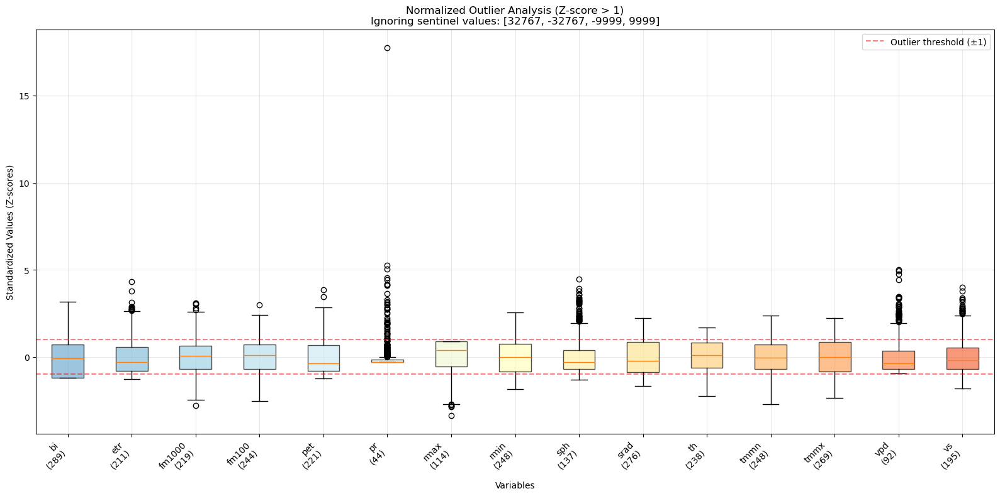


Variable Total  Valid  Ignored  Outliers %      Mean       Std       
--------------------------------------------------------------------------------
bi       1000   680    320      289      42.50  26.64      21.90     
etr      1000   680    320      211      31.03  4.05       3.12      
fm1000   1000   680    320      219      32.21  16.81      4.94      
fm100    1000   680    320      244      35.88  15.17      4.92      
pet      1000   680    320      221      32.50  2.92       2.28      
pr       1000   680    320      44       6.47   1.77       6.26      
rmax     1000   680    320      114      16.76  83.58      18.76     
rmin     1000   680    320      248      36.47  38.51      17.13     
sph      1000   680    320      137      20.15  0.00       0.00      
srad     1000   680    320      276      40.59  170.98     90.09     
th       1000   680    320      238      35.00  205.93     91.52     
tmmn     1000   680    320      248      36.47  273.95     10.61     
tmmx    

In [4]:
variables = ['bi', 'etr', 'fm1000', 'fm100', 'pet', 'pr', 'rmax', 'rmin', 
             'sph', 'srad', 'th', 'tmmn', 'tmmx', 'vpd', 'vs']

#normalized comparison
outlier_info = weather_eda.outlier_analysis_normalized(variables, threshold=1)

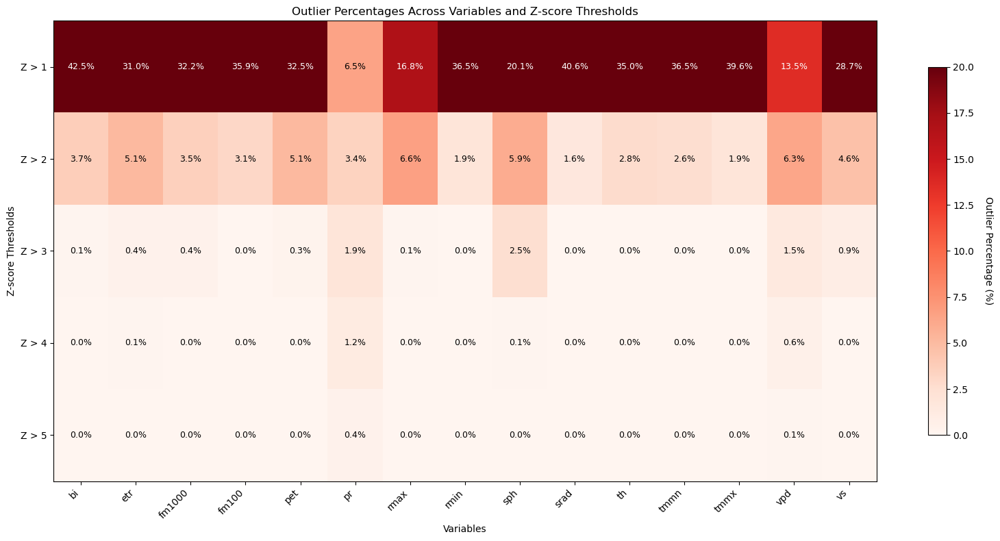

In [5]:
outlier_matrix = weather_eda.outlier_heatmap(variables, thresholds=[1, 2, 3, 4, 5])

In [6]:
# missing data
df = weather_eda.missing_data_report()



Missing Data Breakdown
Variable NaN Count Fill Value Count Missing Value Count  Mask Count Total Missing Missing %
      bi         0                0                   0 119,329,815   119,329,815    40.32%
     etr         0                0                   0 119,329,815   119,329,815    40.32%
  fm1000         0                0                   0 119,329,815   119,329,815    40.32%
   fm100         0                0                   0 119,329,815   119,329,815    40.32%
     pet         0                0                   0 119,329,815   119,329,815    40.32%
      pr         0                0                   0 119,329,815   119,329,815    40.32%
    rmax         0                0                   0 119,329,815   119,329,815    40.32%
    rmin         0                0                   0 119,329,815   119,329,815    40.32%
     sph         0                0                   0 119,329,815   119,329,815    40.32%
    srad         0                0                   0 

In [ ]:
{1,2,3,4,5,--,--,--,--}

Analyzing bi (burning_index_g)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Unitless, Scale: 1.0, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 170.000
Masked fill value: 32767
No scaling needed (scale=1.0, offset=0.0)
Plot data range: 5.795 to 67.989
Valid data points: 483879/810810 (59.7%)
Burning index range: 11.000 to 53.518
Using colormap: YlOrRd, range: 11.000 to 53.518


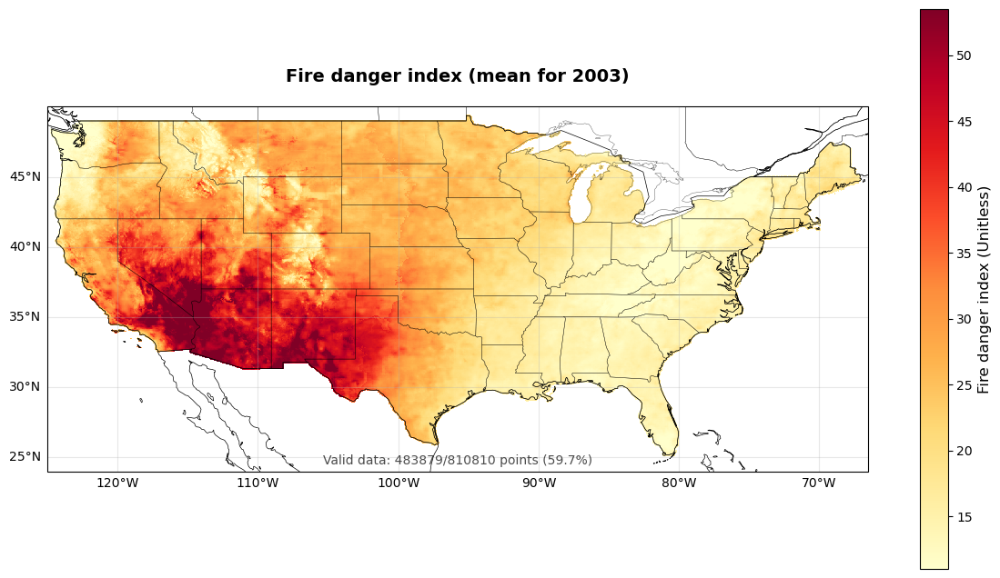

Analyzing fm100 (dead_fuel_moisture_100hr)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Percent, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 1.800 to 32.500
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.180 to 3.250
Plot data range: 0.558 to 2.252
Valid data points: 483879/810810 (59.7%)
Fuel moisture range: 0.799 to 1.903
Using colormap: YlOrBr, range: 0.799 to 1.903


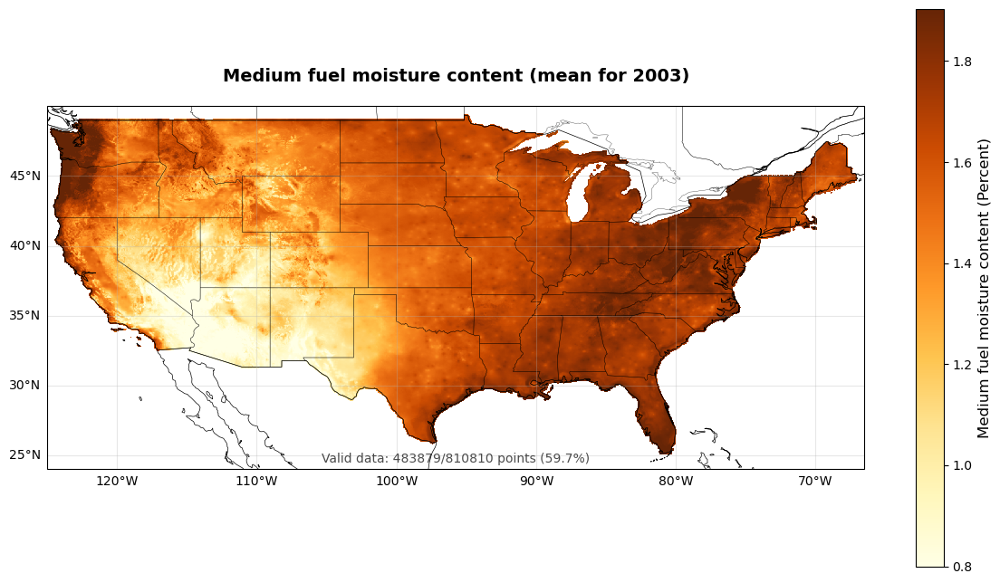

Analyzing fm1000 (dead_fuel_moisture_1000hr)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Percent, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 2.300 to 42.800
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.230 to 4.280
Plot data range: 0.604 to 2.963
Valid data points: 483879/810810 (59.7%)
Fuel moisture range: 0.861 to 2.301
Using colormap: YlOrBr, range: 0.861 to 2.301


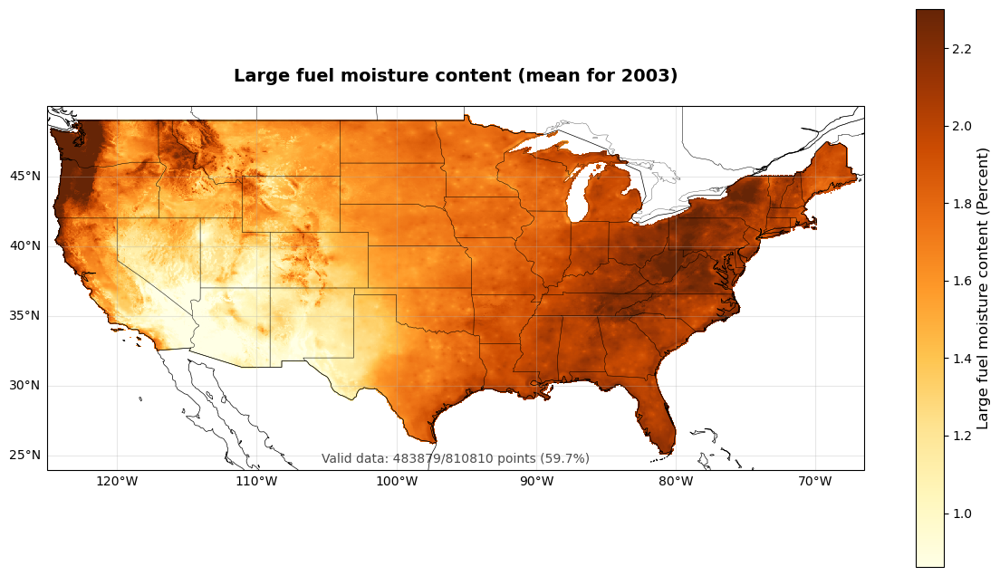

In [10]:
# =============================================================================
# fire related variables
# =============================================================================

# Burning Index - Fire danger assessment
fig_bi = weather_eda.plot_spatial_map('bi', agg_method='mean')
plt.show()

# Dead Fuel Moisture Content (100-hour fuels)
fig_fm100 = weather_eda.plot_spatial_map('fm100', agg_method='mean')
plt.show()

# Dead Fuel Moisture Content (1000-hour fuels)  
fig_fm1000 = weather_eda.plot_spatial_map('fm1000', agg_method='mean')
plt.show()

Analyzing tmmx (air_temperature)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: K, Scale: 0.1, Offset: 220.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 246.800 to 325.500
Masked fill value: 32767
Raw temperature data already in reasonable Kelvin range - skipping scaling
Using raw data: 246.8K to 325.5K
Temperature range: 246.8 to 325.5 K
Plot data range: 271.267 to 306.785
Valid data points: 483879/810810 (59.7%)
Temperature range: 283.3 to 299.7 K
Using colormap: RdYlBu_r, range: 283.344 to 299.733


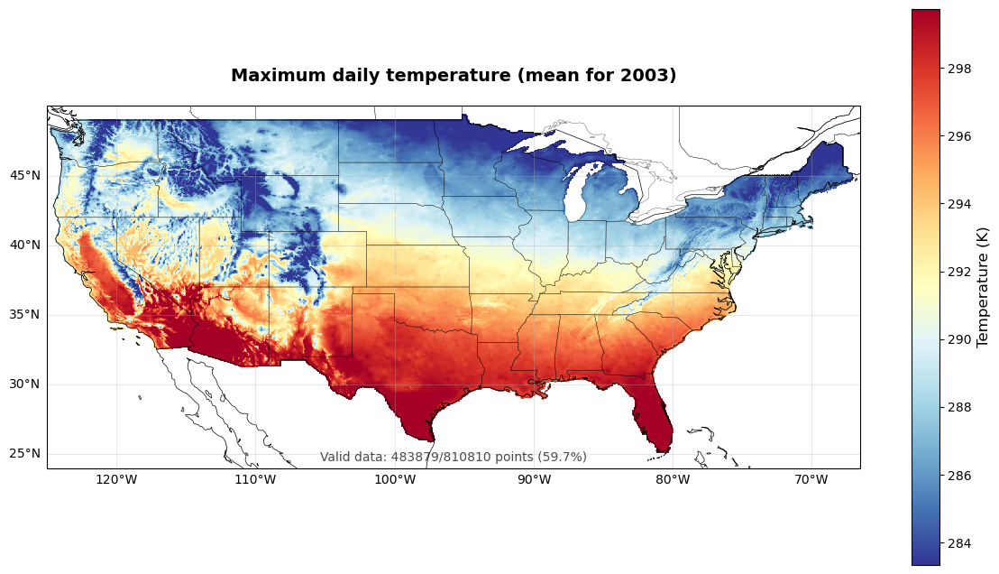

Analyzing tmmn (air_temperature)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: K, Scale: 0.1, Offset: 210.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 237.700 to 310.100
Masked fill value: 32767
Raw temperature data already in reasonable Kelvin range - skipping scaling
Using raw data: 237.7K to 310.1K
Temperature range: 237.7 to 310.1 K
Plot data range: 261.742 to 295.378
Valid data points: 483879/810810 (59.7%)
Temperature range: 271.0 to 287.2 K
Using colormap: coolwarm, range: 271.014 to 287.154


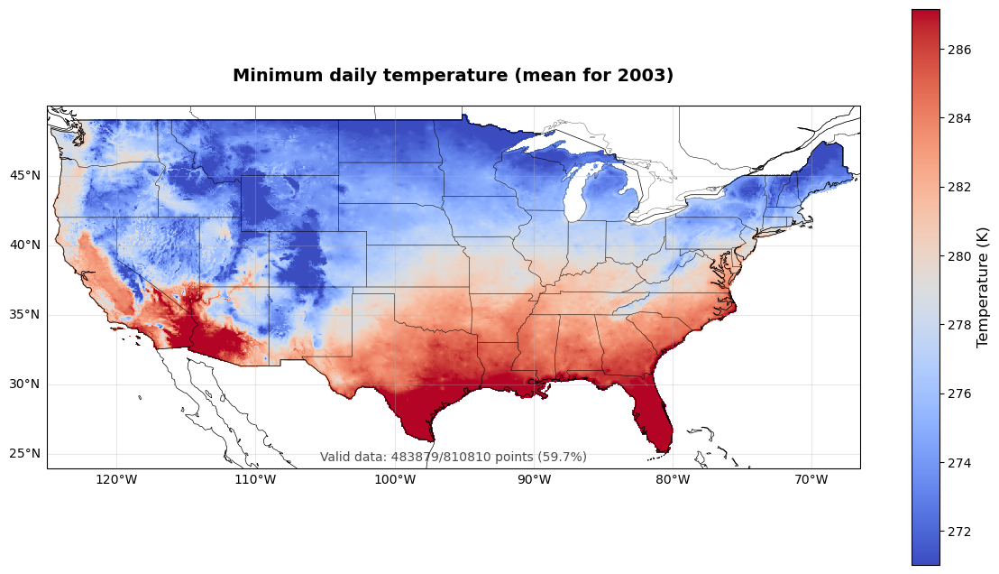

In [11]:
# =============================================================================
# Temp variables 
# =============================================================================

# Maximum Daily Temperature
fig_tmmx = weather_eda.plot_spatial_map('tmmx', agg_method='mean')
plt.show()

# Minimum Daily Temperature
fig_tmmn = weather_eda.plot_spatial_map('tmmn', agg_method='mean')
plt.show()

Analyzing pr (precipitation_amount)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: mm, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 494.500
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.000 to 49.450
Plot data range: 4.320 to 771.380
Valid data points: 483879/810810 (59.7%)
Precipitation range: 0 to 164.840 mm
Using colormap: Blues, range: 0.000 to 164.840


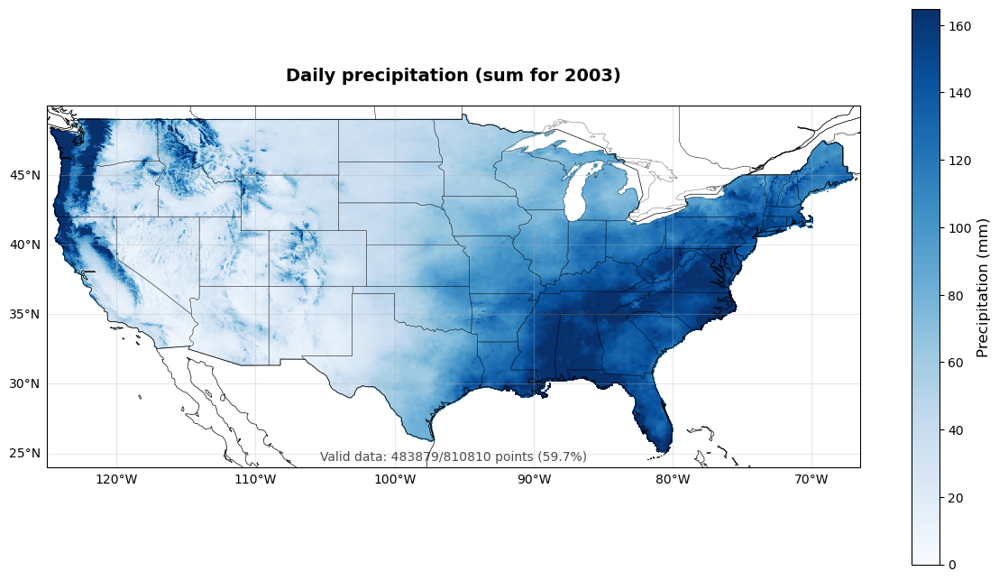

Analyzing etr (potential_evapotranspiration)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: mm, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 24.000
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.000 to 2.400
Plot data range: 0.087 to 1.062
Valid data points: 483879/810810 (59.7%)
Evapotranspiration range: 0.315 to 0.724
Using colormap: BuGn, range: 0.315 to 0.724


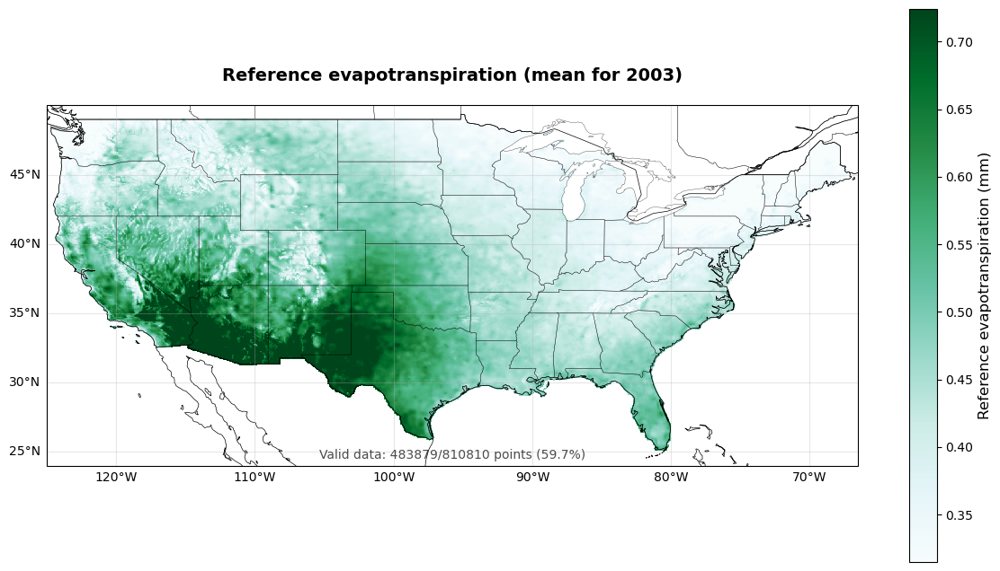

Analyzing pet (potential_evapotranspiration)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: mm, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 15.500
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.000 to 1.550
Plot data range: 0.090 to 0.704
Valid data points: 483879/810810 (59.7%)
Evapotranspiration range: 0.237 to 0.511
Using colormap: BuGn, range: 0.237 to 0.511


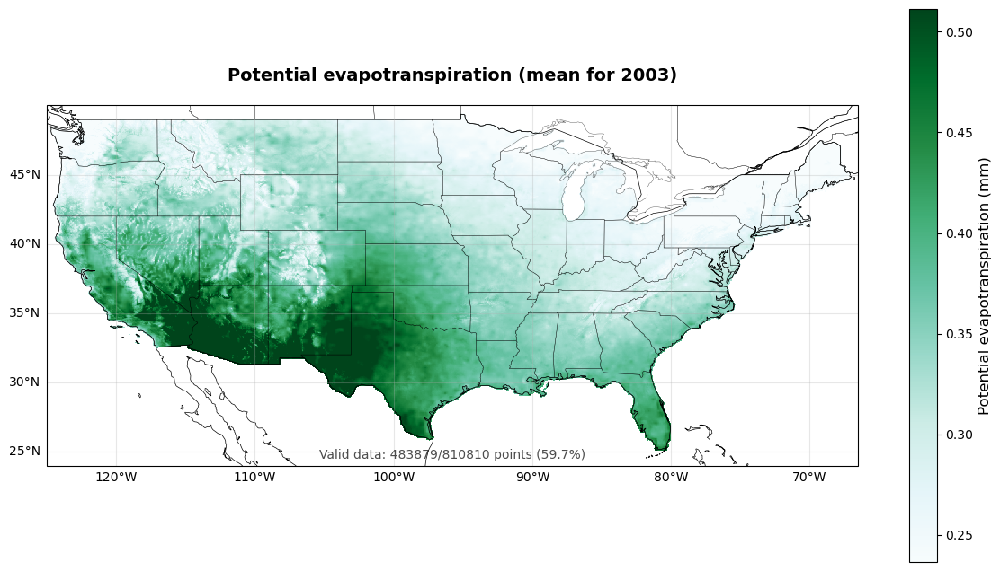

Analyzing vpd (mean_vapor_pressure_deficit)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: kPa, Scale: 0.01, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 8.740
Masked fill value: 32767
Applied scaling: factor=0.01, offset=0.0
After scaling: 0.000 to 0.087
Plot data range: 0.000 to 0.034
Valid data points: 483879/810810 (59.7%)
Vapor pressure deficit range: 0.004 to 0.016
Using colormap: Reds, range: 0.004 to 0.016


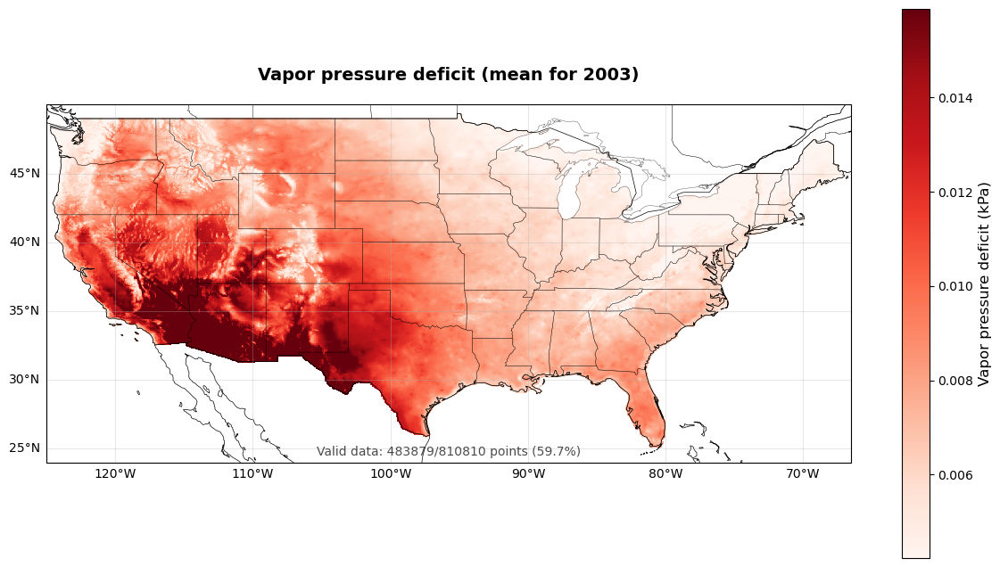

In [12]:
# =============================================================================
# Rain and Water variables
# =============================================================================

# Precipitation Amount
fig_pr = weather_eda.plot_spatial_map('pr', agg_method='sum')  # Sum for total precipitation
plt.show()

# Reference Evapotranspiration
fig_etr = weather_eda.plot_spatial_map('etr', agg_method='mean')
plt.show()

# Potential Evapotranspiration
fig_pet = weather_eda.plot_spatial_map('pet', agg_method='mean')
plt.show()

# Vapor Pressure Deficit
fig_vpd = weather_eda.plot_spatial_map('vpd', agg_method='mean')
plt.show()

Analyzing rmax (relative_humidity)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: %, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 7.200 to 100.000
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.720 to 10.000
Plot data range: 3.525 to 9.991
Valid data points: 483879/810810 (59.7%)
Relative humidity range: 5.4% to 9.7%
Using colormap: Blues, range: 5.353 to 9.656


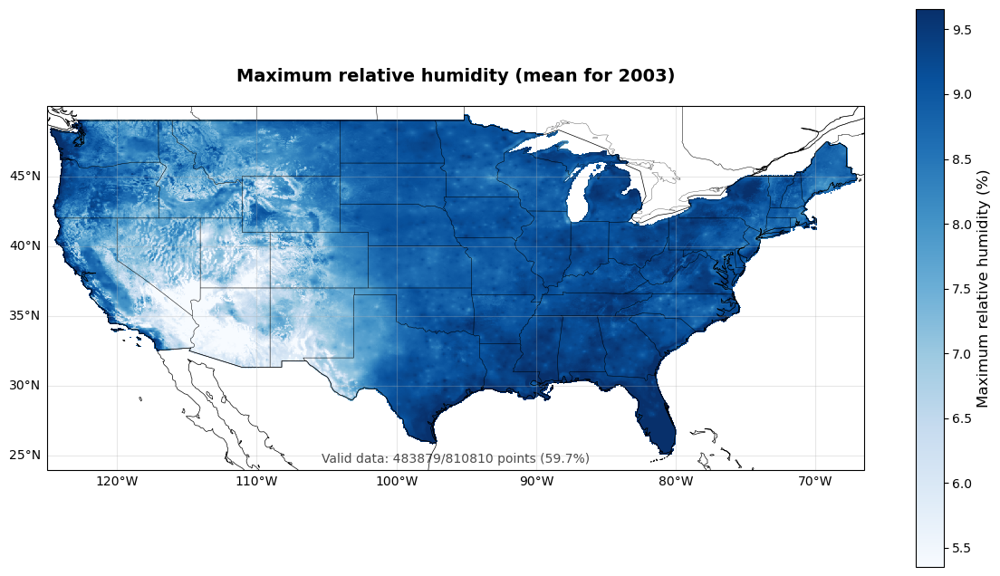

Analyzing rmin (relative_humidity)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: %, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.500 to 100.000
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.050 to 10.000
Plot data range: 1.295 to 7.070
Valid data points: 483879/810810 (59.7%)
Relative humidity range: 1.8% to 5.5%
Using colormap: Blues, range: 1.768 to 5.478


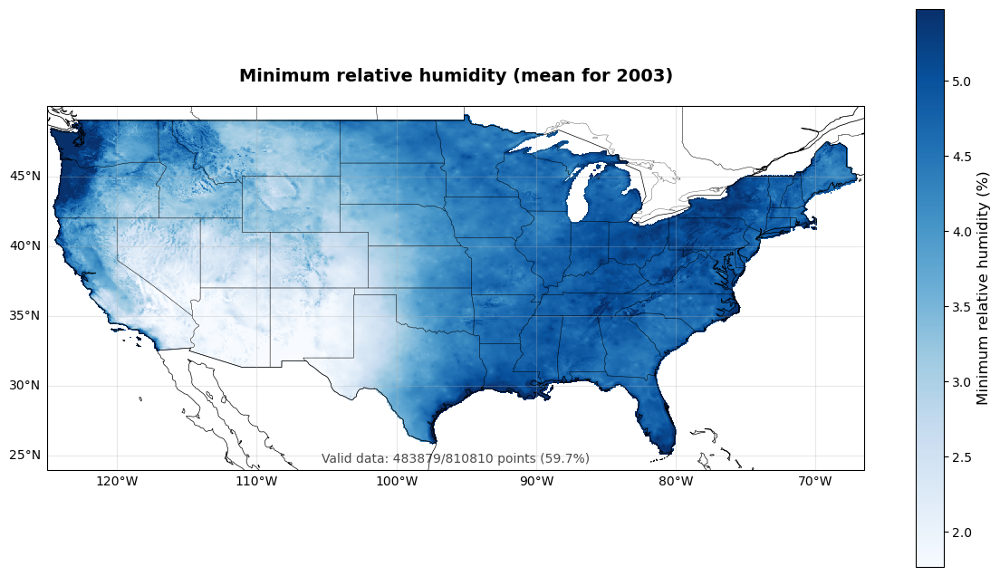

Analyzing sph (specific_humidity)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: kg/kg, Scale: 1e-05, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 0.024
Masked fill value: 32767
Applied scaling: factor=1e-05, offset=0.0
After scaling: 0.000 to 0.000
Plot data range: 0.000 to 0.000
Valid data points: 483879/810810 (59.7%)
Specific humidity range: 0.000000 to 0.000000
Using colormap: Blues, range: 0.000 to 0.000


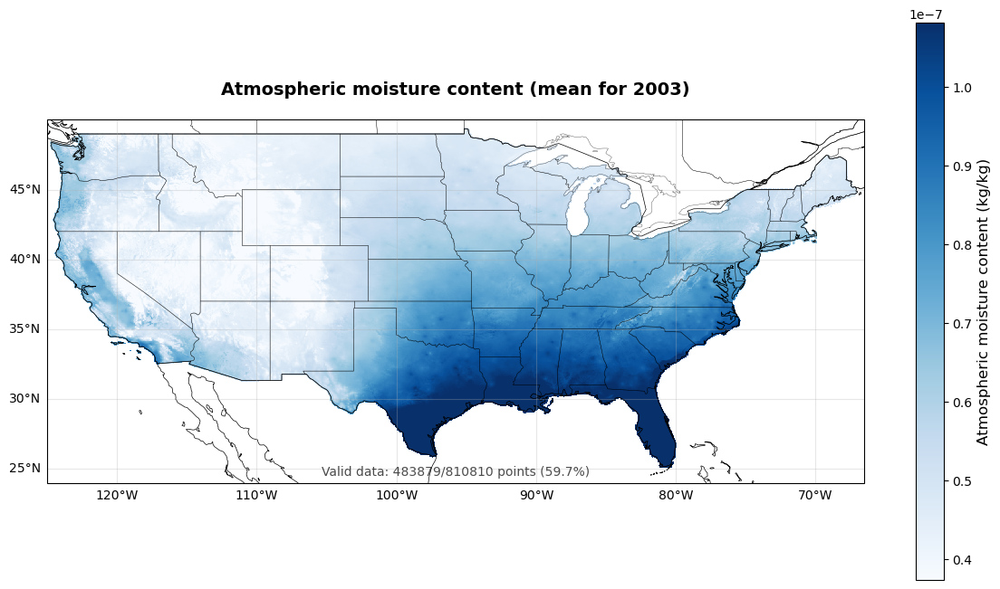

In [13]:
# =============================================================================
# Humidaity Variables
# =============================================================================

# Maximum Relative Humidity
fig_rmax = weather_eda.plot_spatial_map('rmax', agg_method='mean')
plt.show()

# Minimum Relative Humidity
fig_rmin = weather_eda.plot_spatial_map('rmin', agg_method='mean')
plt.show()

# Specific Humidity
fig_sph = weather_eda.plot_spatial_map('sph', agg_method='mean')
plt.show()

Analyzing vs (wind_speed)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: m/s, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.200 to 20.700
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.020 to 2.070
Plot data range: 0.182 to 0.714
Valid data points: 483879/810810 (59.7%)
Wind speed range: 0.0 to 0.5
Using colormap: plasma, range: 0.000 to 0.499


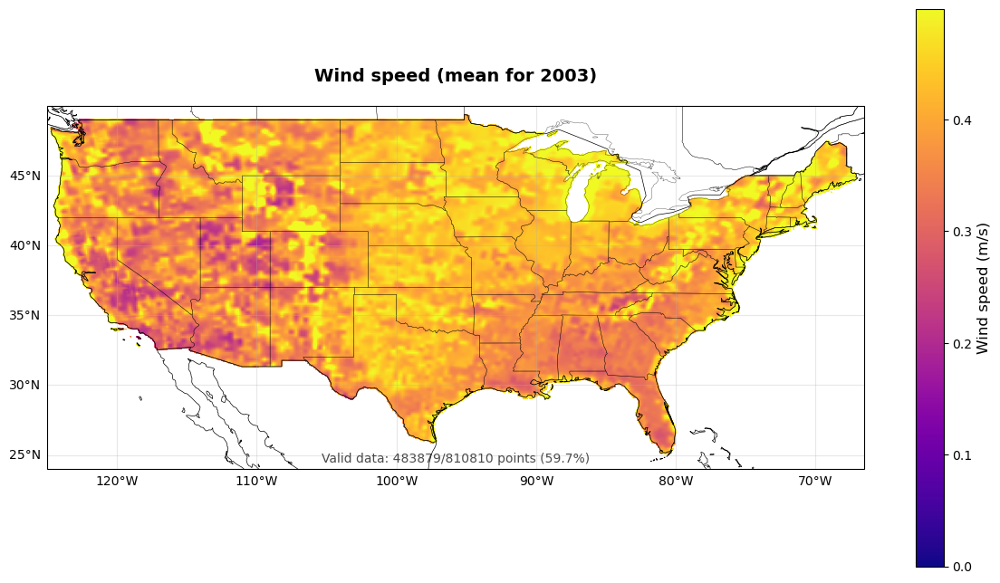

Analyzing th (wind_from_direction)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Degrees Clockwise from north, Scale: 1.0, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 359.000
Masked fill value: 32767
No scaling needed (scale=1.0, offset=0.0)
Plot data range: 123.244 to 359.000
Valid data points: 483879/810810 (59.7%)
Wind direction range: 0° to 360°
Using colormap: hsv, range: 0.000 to 360.000


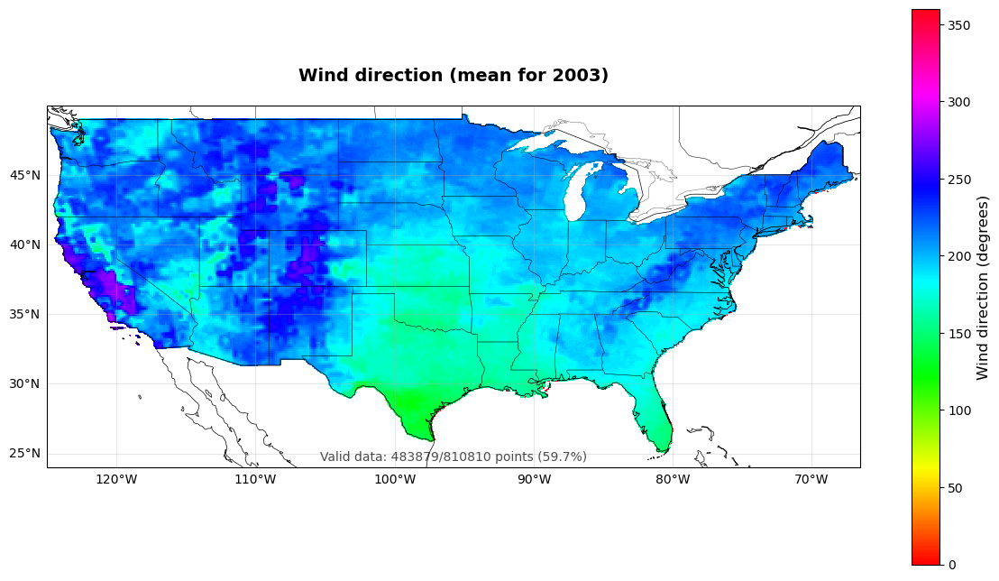

In [14]:
# =============================================================================
# Wind
# =============================================================================

# Wind Speed
fig_vs = weather_eda.plot_spatial_map('vs', agg_method='mean')
plt.show()

# Wind Direction
fig_th = weather_eda.plot_spatial_map('th', agg_method='mean')
plt.show()

Analyzing srad (surface_downwelling_shortwave_flux_in_air)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: W m-2, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 11.300 to 443.200
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 1.130 to 44.320
Plot data range: 14.319 to 26.371
Valid data points: 483879/810810 (59.7%)
Solar radiation range: 16.1 to 23.2
Using colormap: YlOrRd, range: 16.084 to 23.178


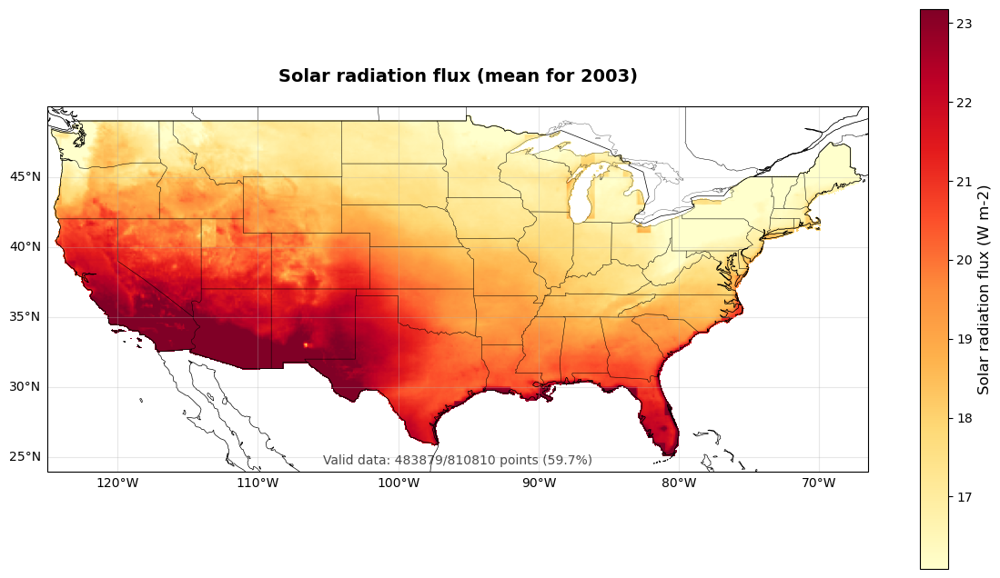

In [15]:
# =============================================================================
# Solar Radiation 
# =============================================================================

# Surface Downwelling Shortwave Flux (Solar Radiation)
fig_srad = weather_eda.plot_spatial_map('srad', agg_method='mean')
plt.show()

Analyzing tmmx (air_temperature)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: K, Scale: 0.1, Offset: 220.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 246.800 to 325.500
Masked fill value: 32767
Raw temperature data already in reasonable Kelvin range - skipping scaling
Using raw data: 246.8K to 325.5K
Temperature range: 246.8 to 325.5 K
Plot data range: 282.100 to 324.500
Valid data points: 483879/810810 (59.7%)
Temperature range: 297.7 to 312.4 K
Using colormap: RdYlBu_r, range: 297.700 to 312.400


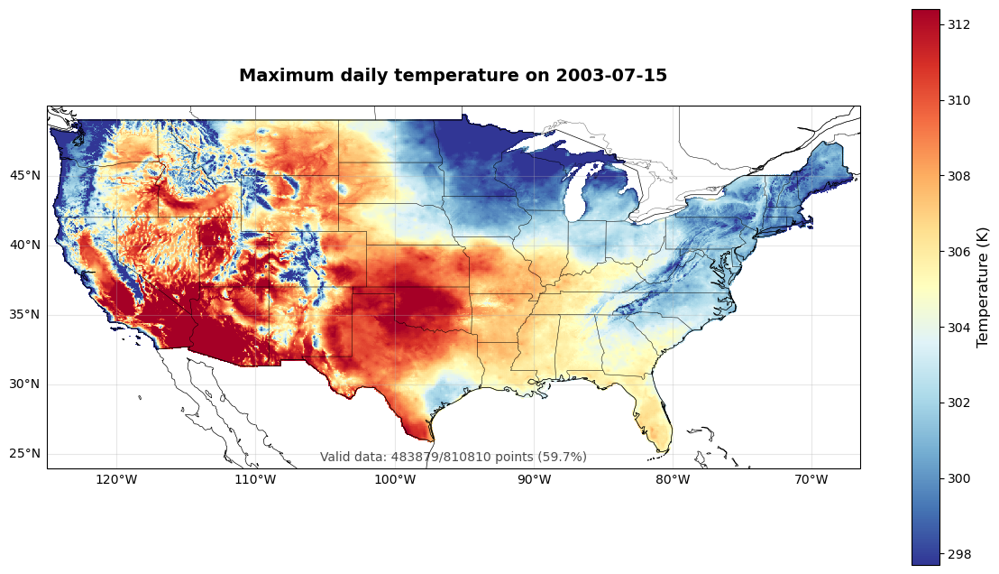

Analyzing tmmn (air_temperature)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: K, Scale: 0.1, Offset: 210.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 237.700 to 310.100
Masked fill value: 32767
Raw temperature data already in reasonable Kelvin range - skipping scaling
Using raw data: 237.7K to 310.1K
Temperature range: 237.7 to 310.1 K
Plot data range: 244.200 to 286.300
Valid data points: 483879/810810 (59.7%)
Temperature range: 250.9 to 277.4 K
Using colormap: coolwarm, range: 250.900 to 277.400


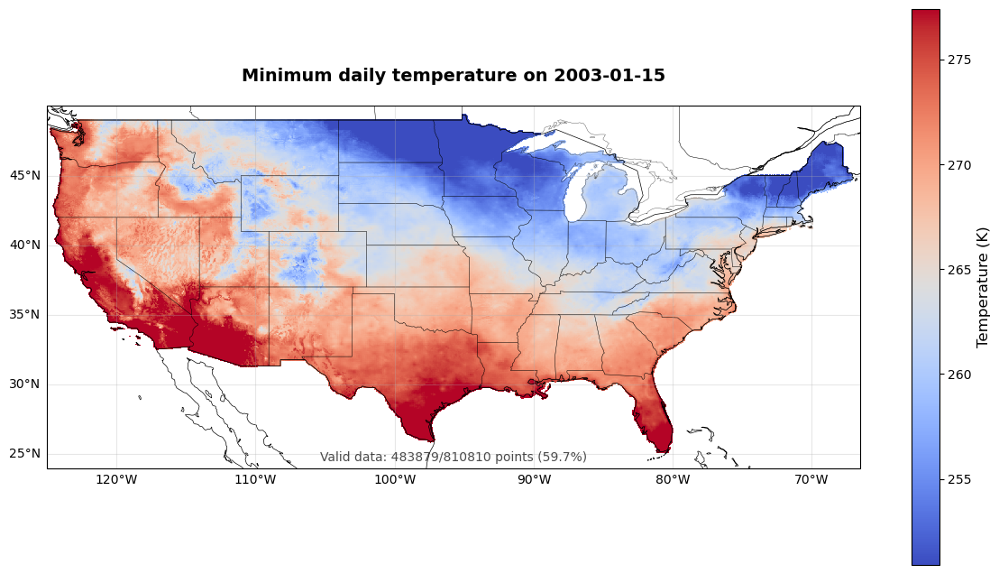

Analyzing bi (burning_index_g)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Unitless, Scale: 1.0, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 170.000
Masked fill value: 32767
No scaling needed (scale=1.0, offset=0.0)
Plot data range: 0.000 to 99.000
Valid data points: 483879/810810 (59.7%)
Burning index range: 0.000 to 67.000
Using colormap: YlOrRd, range: 0.000 to 67.000


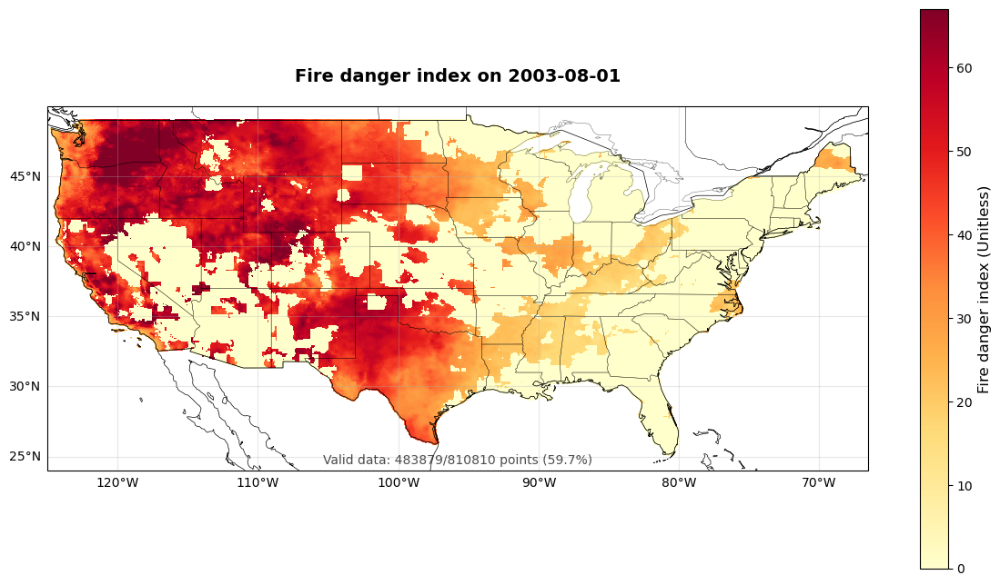

Analyzing vpd (mean_vapor_pressure_deficit)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: kPa, Scale: 0.01, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 8.740
Masked fill value: 32767
Applied scaling: factor=0.01, offset=0.0
After scaling: 0.000 to 0.087
Plot data range: 0.002 to 0.087
Valid data points: 483879/810810 (59.7%)
Vapor pressure deficit range: 0.013 to 0.044
Using colormap: Reds, range: 0.013 to 0.044


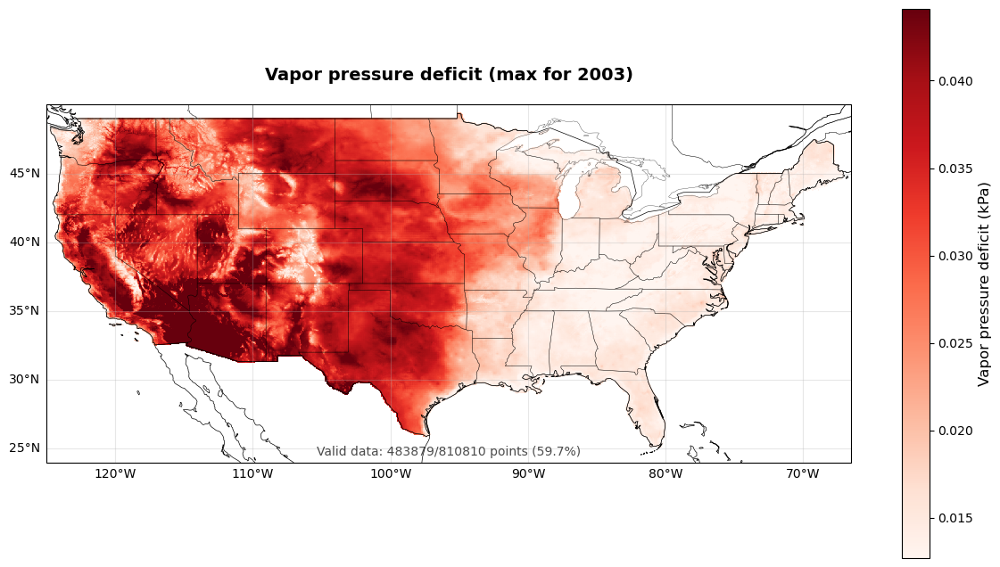

Analyzing pr (precipitation_amount)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: mm, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 494.500
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.000 to 49.450
Plot data range: 4.320 to 771.380
Valid data points: 483879/810810 (59.7%)
Precipitation range: 0 to 164.840 mm
Using colormap: Blues, range: 0.000 to 164.840


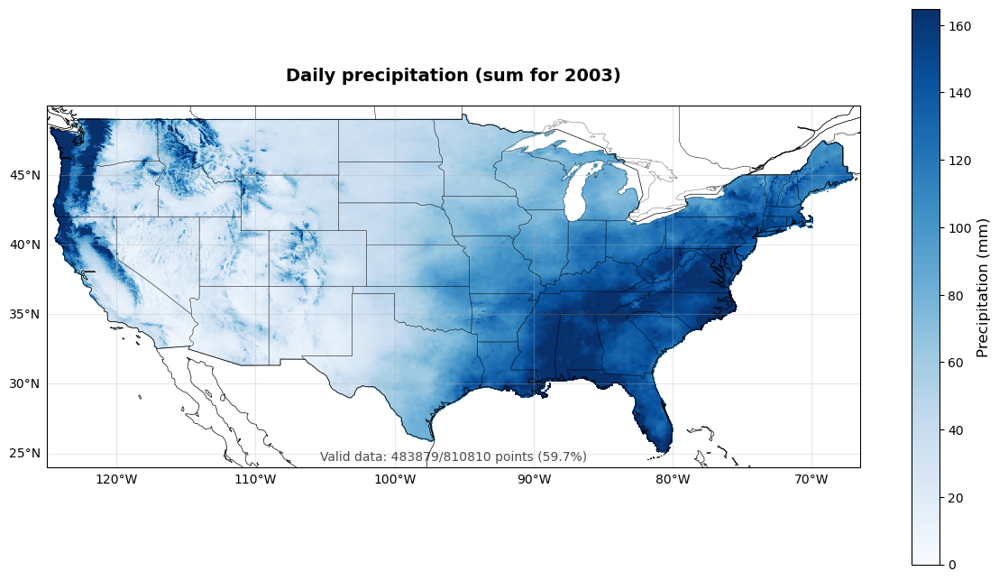

In [16]:
# =============================================================================
# Seasonal Temporal
# =============================================================================

# Summer maximum temperatures (July 15th example)
fig_summer_temp = weather_eda.plot_spatial_map('tmmx', date='2003-07-15')
plt.show()

# Winter minimum temperatures (January 15th example)
fig_winter_temp = weather_eda.plot_spatial_map('tmmn', date='2003-01-15')
plt.show()

# Peak fire season burning index (August 1st example)
fig_fire_season = weather_eda.plot_spatial_map('bi', date='2003-08-01')
plt.show()

# Summer drought conditions - maximum VPD
fig_drought = weather_eda.plot_spatial_map('vpd', agg_method='max')
plt.show()

# Total annual precipitation
fig_annual_precip = weather_eda.plot_spatial_map('pr', agg_method='sum')
plt.show()

Analyzing bi (burning_index_g)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Unitless, Scale: 1.0, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 170.000
Masked fill value: 32767
No scaling needed (scale=1.0, offset=0.0)
Plot data range: 5.795 to 67.989
Valid data points: 483879/810810 (59.7%)
Burning index range: 11.000 to 53.518
Using colormap: YlOrRd, range: 11.000 to 53.518


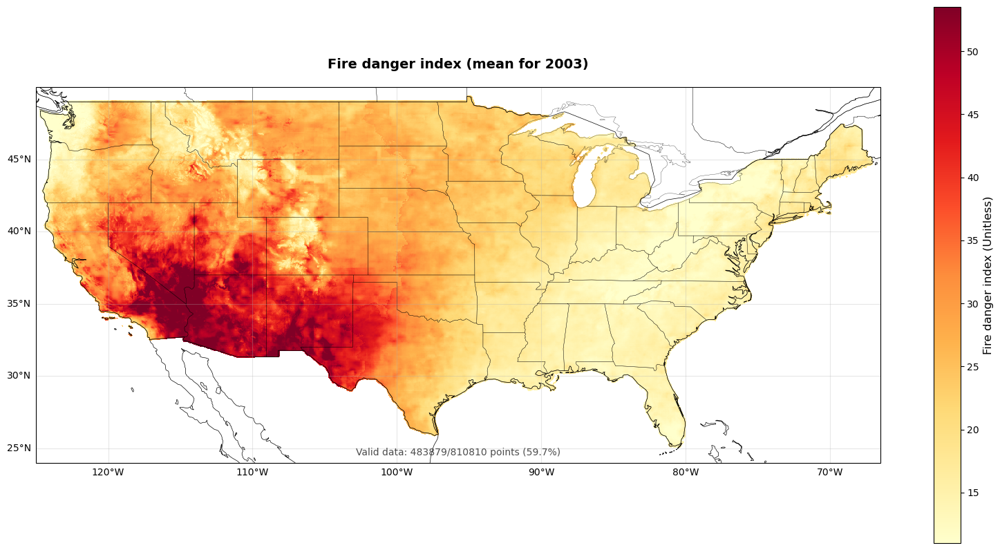

Analyzing fm100 (dead_fuel_moisture_100hr)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Percent, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 1.800 to 32.500
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.180 to 3.250
Plot data range: 0.340 to 2.540
Valid data points: 483879/810810 (59.7%)
Fuel moisture range: 0.600 to 2.200
Using colormap: YlOrBr, range: 0.600 to 2.200


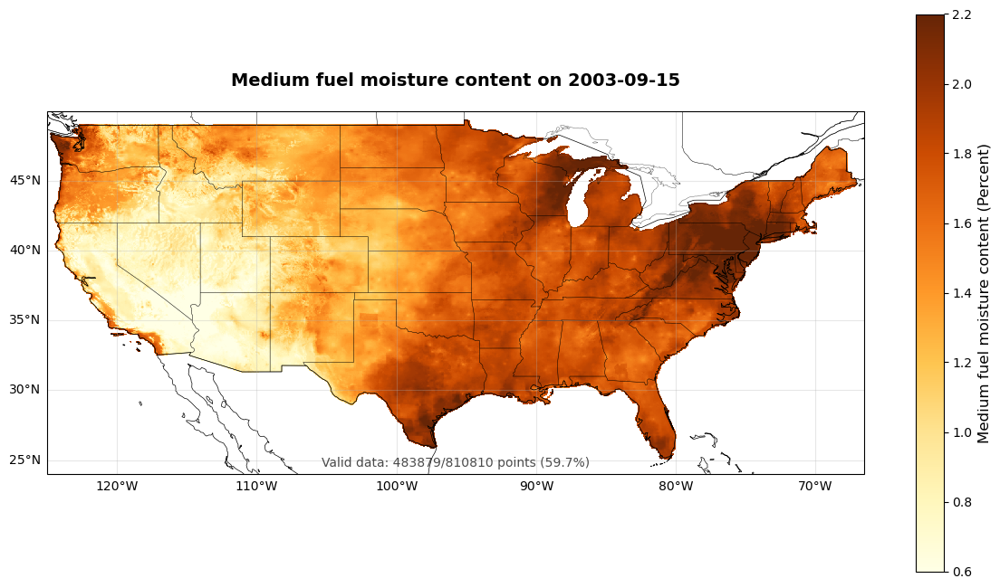

Analyzing tmmx (air_temperature)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: K, Scale: 0.1, Offset: 220.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 246.800 to 325.500
Masked fill value: 32767
Raw temperature data already in reasonable Kelvin range - skipping scaling
Using raw data: 246.8K to 325.5K
Temperature range: 246.8 to 325.5 K
Plot data range: 289.600 to 325.500
Valid data points: 483879/810810 (59.7%)
Temperature range: 303.4 to 315.7 K
Using colormap: RdYlBu_r, range: 303.400 to 315.700


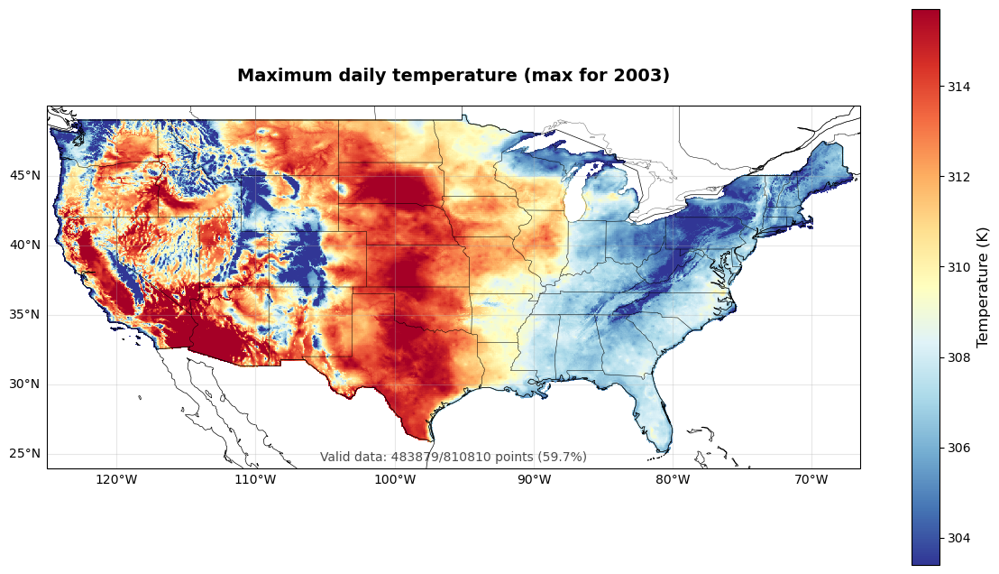

Analyzing vs (wind_speed)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: m/s, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.200 to 20.700
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.020 to 2.070
Plot data range: 0.400 to 2.070
Valid data points: 483879/810810 (59.7%)
Wind speed range: 0.0 to 1.4
Using colormap: plasma, range: 0.000 to 1.410


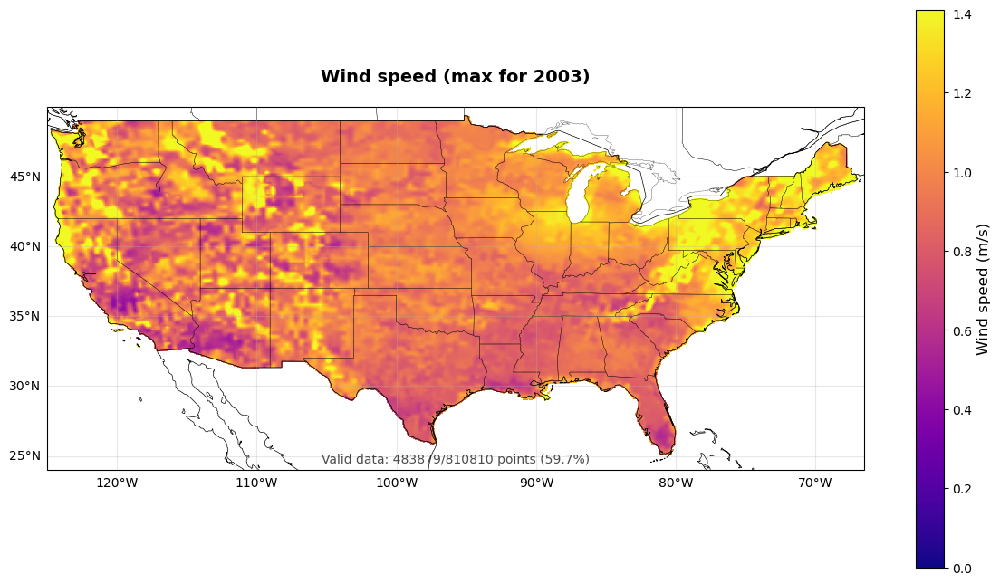

Analyzing rmin (relative_humidity)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: %, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.500 to 100.000
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.050 to 10.000
Plot data range: 0.050 to 3.760
Valid data points: 483879/810810 (59.7%)
Relative humidity range: 0.4% to 2.8%
Using colormap: Blues, range: 0.360 to 2.790


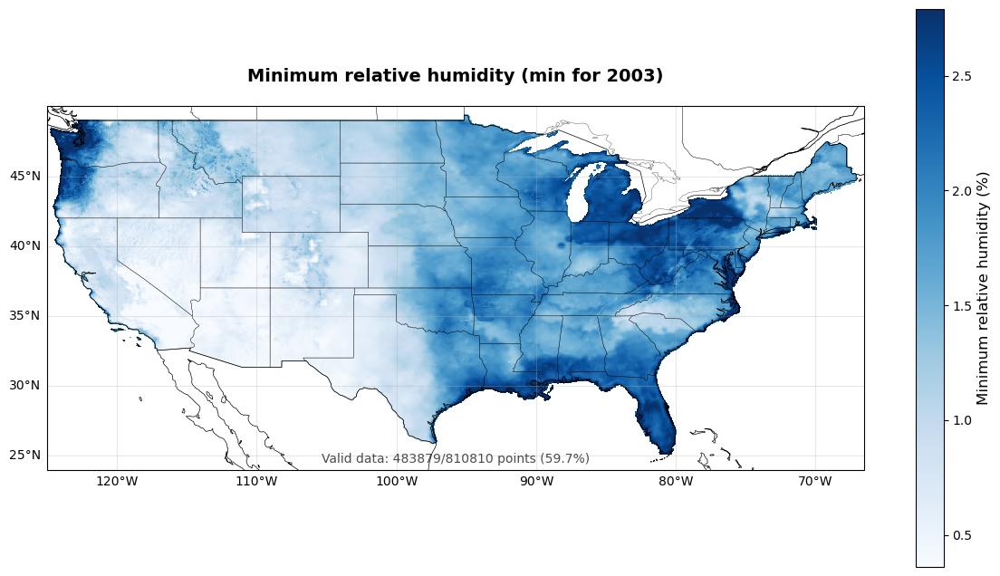

In [17]:
# =============================================================================
# Random Ideas
# =============================================================================

# more detailed look - mean
fig_detailed = weather_eda.plot_spatial_map('bi', agg_method='mean', figsize=(16, 10))
plt.show()

# specific date 
fig_specific = weather_eda.plot_spatial_map('fm100', date='2003-09-15')
plt.show()

# Maximum values over time (extreme conditions)
fig_extreme_temp = weather_eda.plot_spatial_map('tmmx', agg_method='max')
plt.show()

fig_extreme_wind = weather_eda.plot_spatial_map('vs', agg_method='max')
plt.show()

# Minimum values over time
fig_min_humidity = weather_eda.plot_spatial_map('rmin', agg_method='min')
plt.show()


Plotting BI: Fire danger index
Analyzing bi (burning_index_g)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Unitless, Scale: 1.0, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 170.000
Masked fill value: 32767
No scaling needed (scale=1.0, offset=0.0)
Plot data range: 5.795 to 67.989
Valid data points: 483879/810810 (59.7%)
Burning index range: 11.000 to 53.518
Using colormap: YlOrRd, range: 11.000 to 53.518


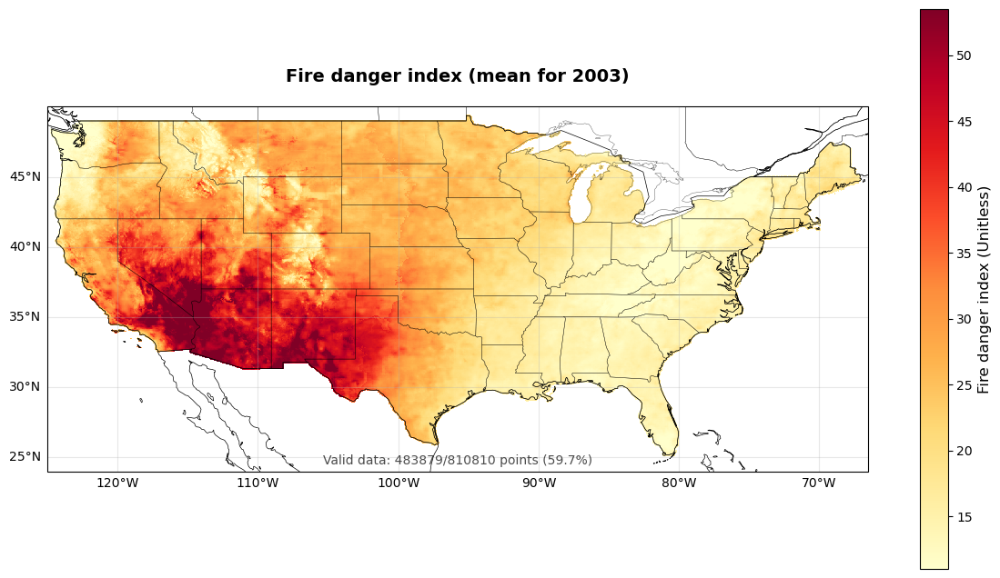


Plotting ETR: Reference evapotranspiration
Analyzing etr (potential_evapotranspiration)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: mm, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 24.000
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.000 to 2.400
Plot data range: 0.087 to 1.062
Valid data points: 483879/810810 (59.7%)
Evapotranspiration range: 0.315 to 0.724
Using colormap: BuGn, range: 0.315 to 0.724


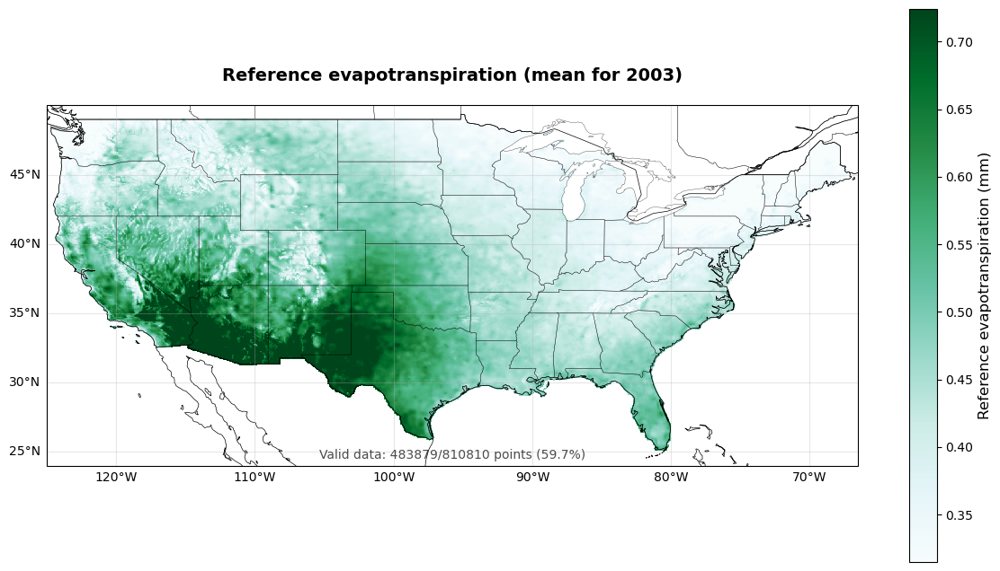


Plotting FM1000: Large fuel moisture content
Analyzing fm1000 (dead_fuel_moisture_1000hr)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Percent, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 2.300 to 42.800
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.230 to 4.280
Plot data range: 0.604 to 2.963
Valid data points: 483879/810810 (59.7%)
Fuel moisture range: 0.861 to 2.301
Using colormap: YlOrBr, range: 0.861 to 2.301


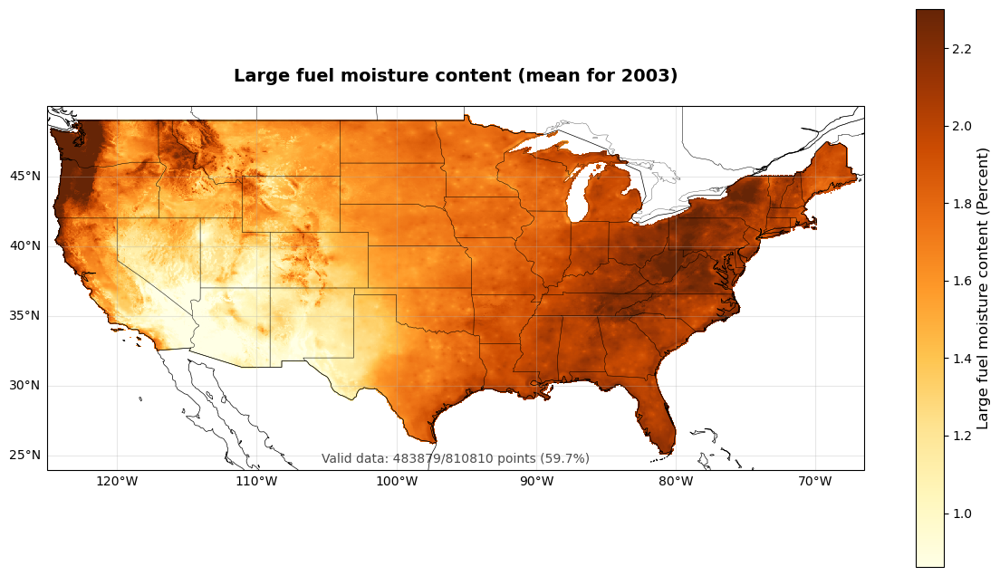


Plotting FM100: Medium fuel moisture content
Analyzing fm100 (dead_fuel_moisture_100hr)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Percent, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 1.800 to 32.500
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.180 to 3.250
Plot data range: 0.558 to 2.252
Valid data points: 483879/810810 (59.7%)
Fuel moisture range: 0.799 to 1.903
Using colormap: YlOrBr, range: 0.799 to 1.903


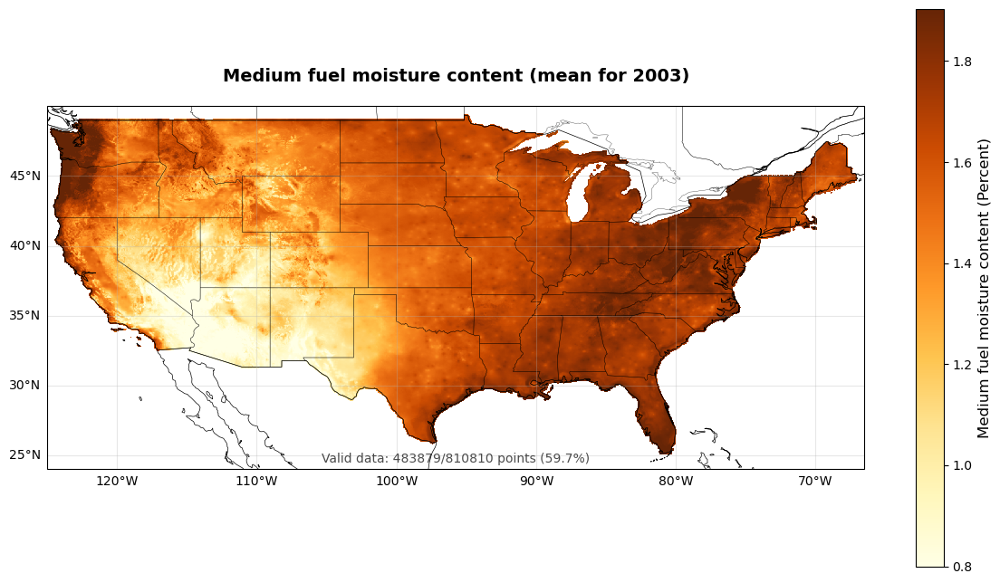


Plotting PET: Potential evapotranspiration
Analyzing pet (potential_evapotranspiration)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: mm, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 15.500
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.000 to 1.550
Plot data range: 0.090 to 0.704
Valid data points: 483879/810810 (59.7%)
Evapotranspiration range: 0.237 to 0.511
Using colormap: BuGn, range: 0.237 to 0.511


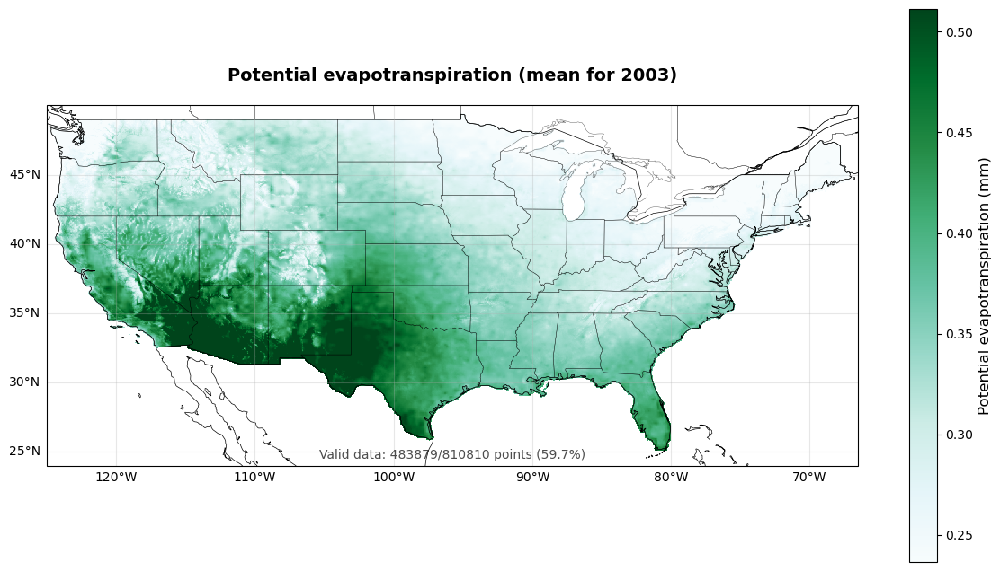


Plotting PR: Daily precipitation
Analyzing pr (precipitation_amount)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: mm, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 494.500
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.000 to 49.450
Plot data range: 0.012 to 2.113
Valid data points: 483879/810810 (59.7%)
Precipitation range: 0 to 0.452 mm
Using colormap: Blues, range: 0.000 to 0.452


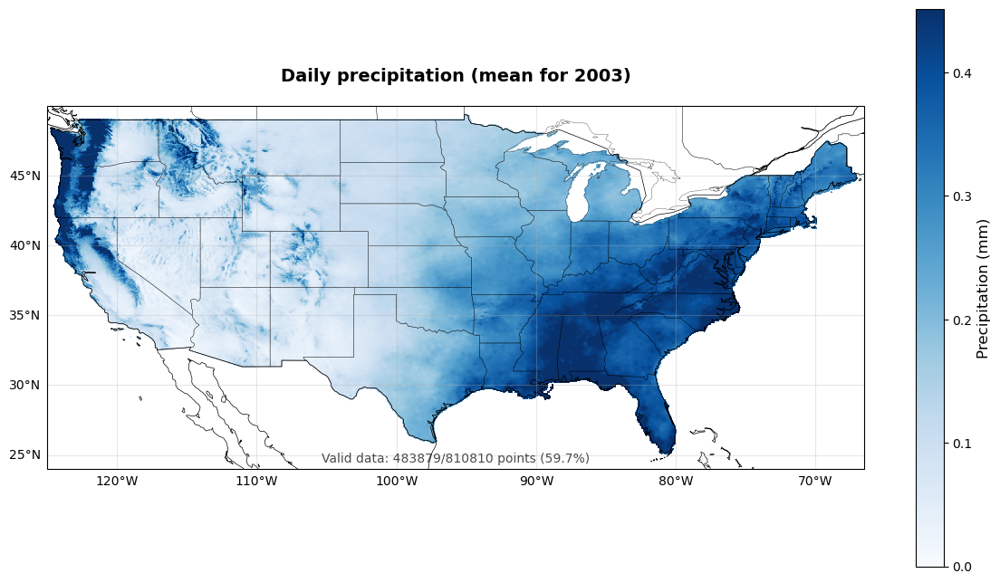


Plotting RMAX: Maximum relative humidity
Analyzing rmax (relative_humidity)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: %, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 7.200 to 100.000
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.720 to 10.000
Plot data range: 3.525 to 9.991
Valid data points: 483879/810810 (59.7%)
Relative humidity range: 5.4% to 9.7%
Using colormap: Blues, range: 5.353 to 9.656


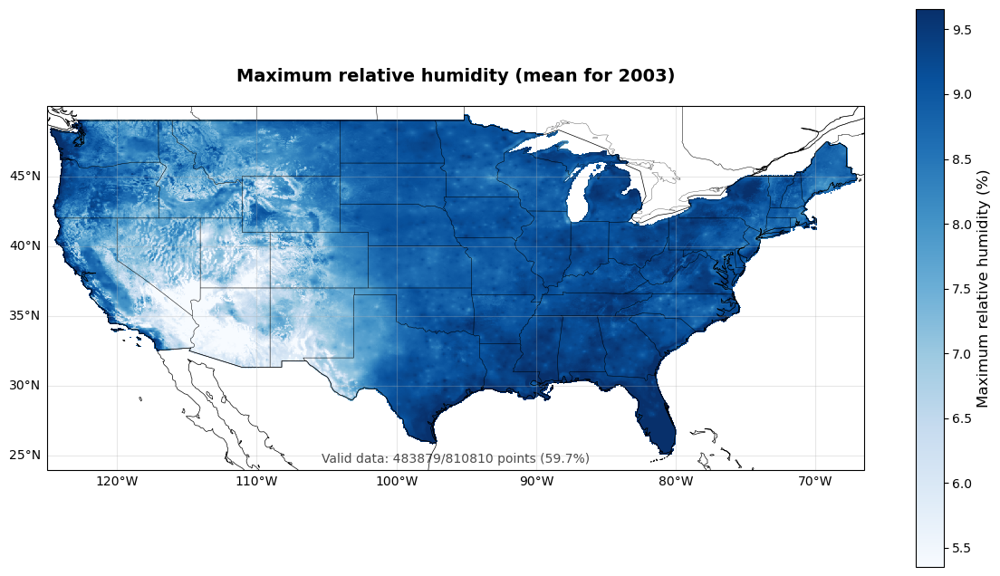


Plotting RMIN: Minimum relative humidity
Analyzing rmin (relative_humidity)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: %, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.500 to 100.000
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.050 to 10.000
Plot data range: 1.295 to 7.070
Valid data points: 483879/810810 (59.7%)
Relative humidity range: 1.8% to 5.5%
Using colormap: Blues, range: 1.768 to 5.478


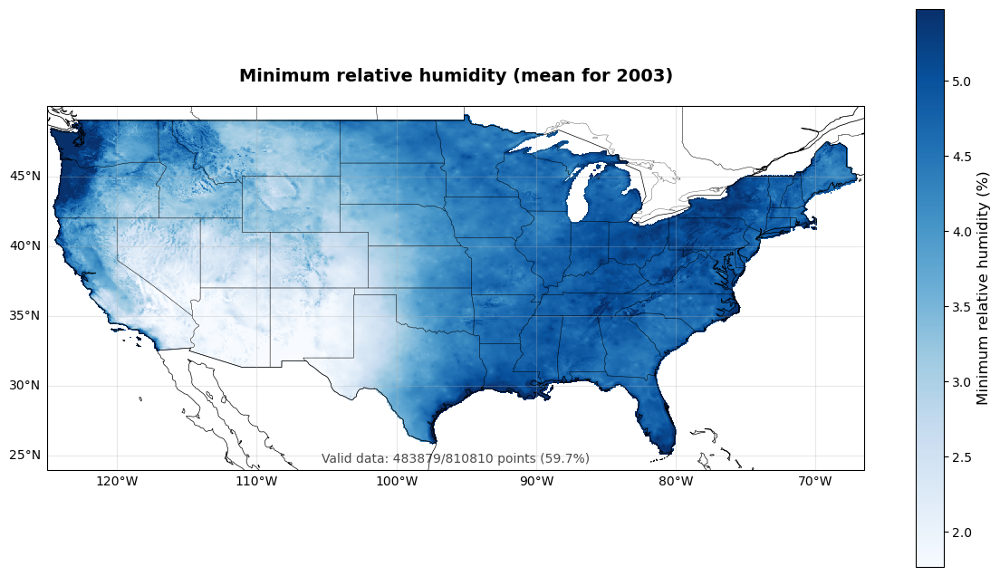


Plotting SPH: Atmospheric moisture content
Analyzing sph (specific_humidity)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: kg/kg, Scale: 1e-05, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 0.024
Masked fill value: 32767
Applied scaling: factor=1e-05, offset=0.0
After scaling: 0.000 to 0.000
Plot data range: 0.000 to 0.000
Valid data points: 483879/810810 (59.7%)
Specific humidity range: 0.000000 to 0.000000
Using colormap: Blues, range: 0.000 to 0.000


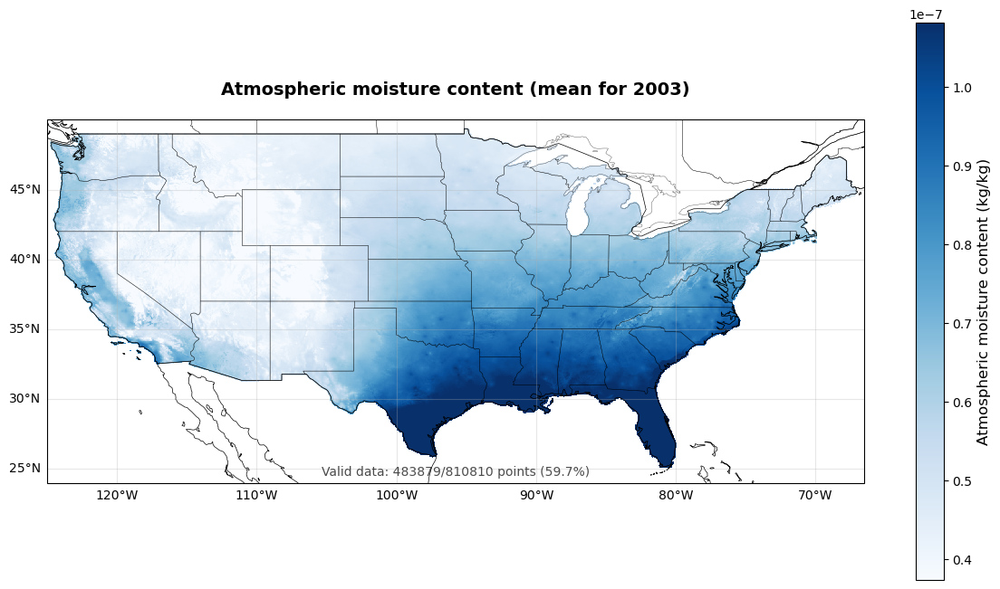


Plotting SRAD: Solar radiation flux
Analyzing srad (surface_downwelling_shortwave_flux_in_air)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: W m-2, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 11.300 to 443.200
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 1.130 to 44.320
Plot data range: 14.319 to 26.371
Valid data points: 483879/810810 (59.7%)
Solar radiation range: 16.1 to 23.2
Using colormap: YlOrRd, range: 16.084 to 23.178


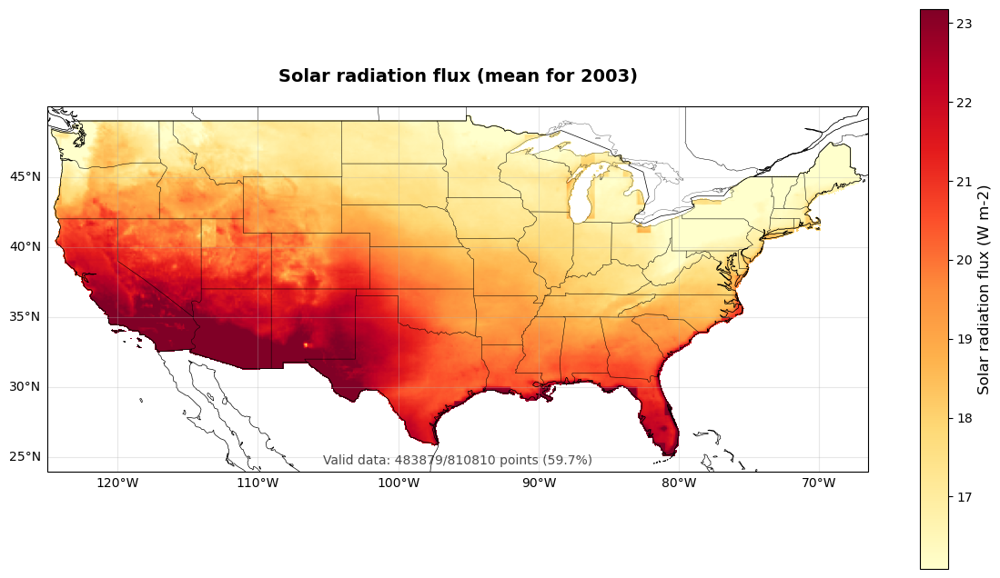


Plotting TH: Wind direction
Analyzing th (wind_from_direction)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Degrees Clockwise from north, Scale: 1.0, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 359.000
Masked fill value: 32767
No scaling needed (scale=1.0, offset=0.0)
Plot data range: 123.244 to 359.000
Valid data points: 483879/810810 (59.7%)
Wind direction range: 0° to 360°
Using colormap: hsv, range: 0.000 to 360.000


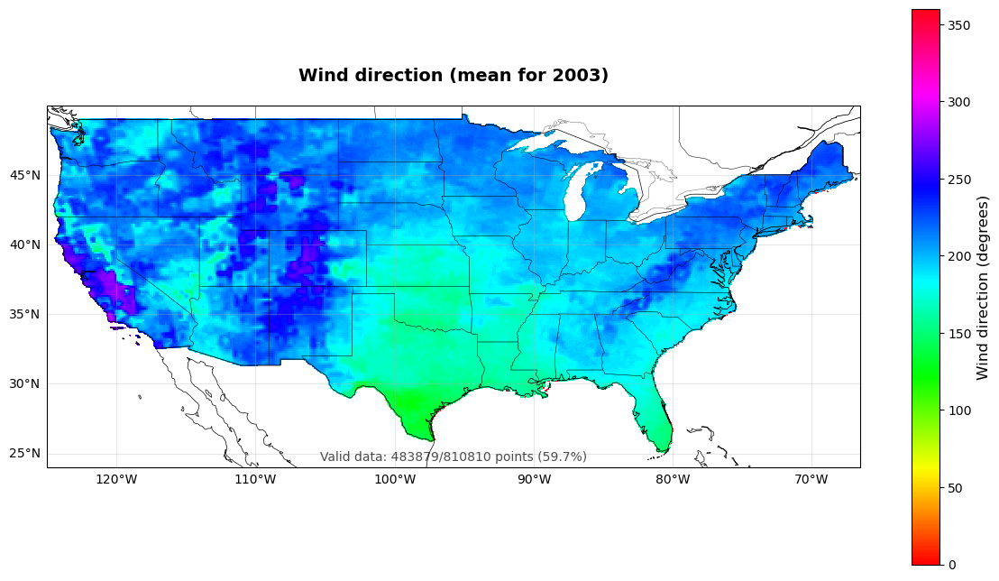


Plotting TMMN: Minimum daily temperature
Analyzing tmmn (air_temperature)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: K, Scale: 0.1, Offset: 210.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 237.700 to 310.100
Masked fill value: 32767
Raw temperature data already in reasonable Kelvin range - skipping scaling
Using raw data: 237.7K to 310.1K
Temperature range: 237.7 to 310.1 K
Plot data range: 261.742 to 295.378
Valid data points: 483879/810810 (59.7%)
Temperature range: 271.0 to 287.2 K
Using colormap: coolwarm, range: 271.014 to 287.154


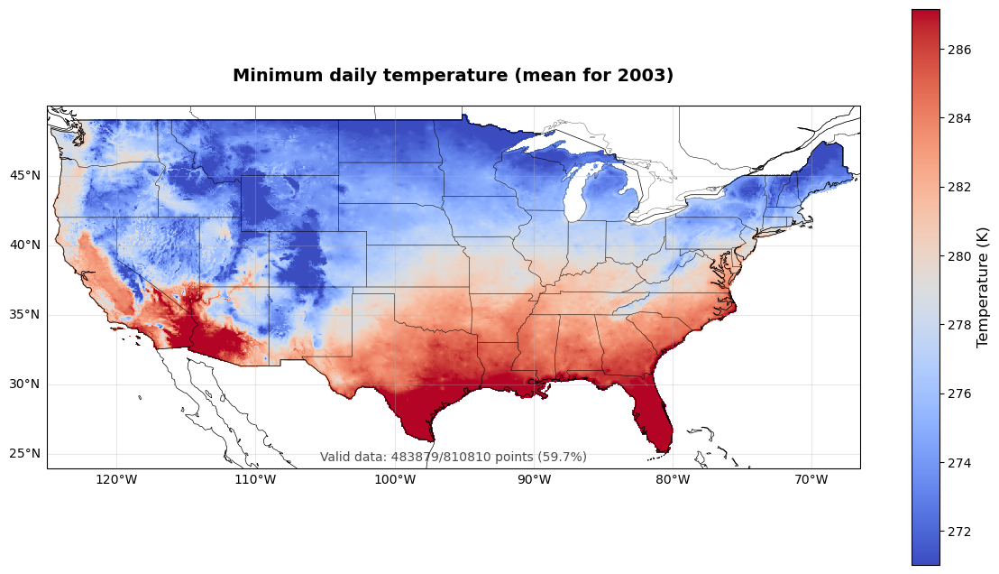


Plotting TMMX: Maximum daily temperature
Analyzing tmmx (air_temperature)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: K, Scale: 0.1, Offset: 220.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 246.800 to 325.500
Masked fill value: 32767
Raw temperature data already in reasonable Kelvin range - skipping scaling
Using raw data: 246.8K to 325.5K
Temperature range: 246.8 to 325.5 K
Plot data range: 271.267 to 306.785
Valid data points: 483879/810810 (59.7%)
Temperature range: 283.3 to 299.7 K
Using colormap: RdYlBu_r, range: 283.344 to 299.733


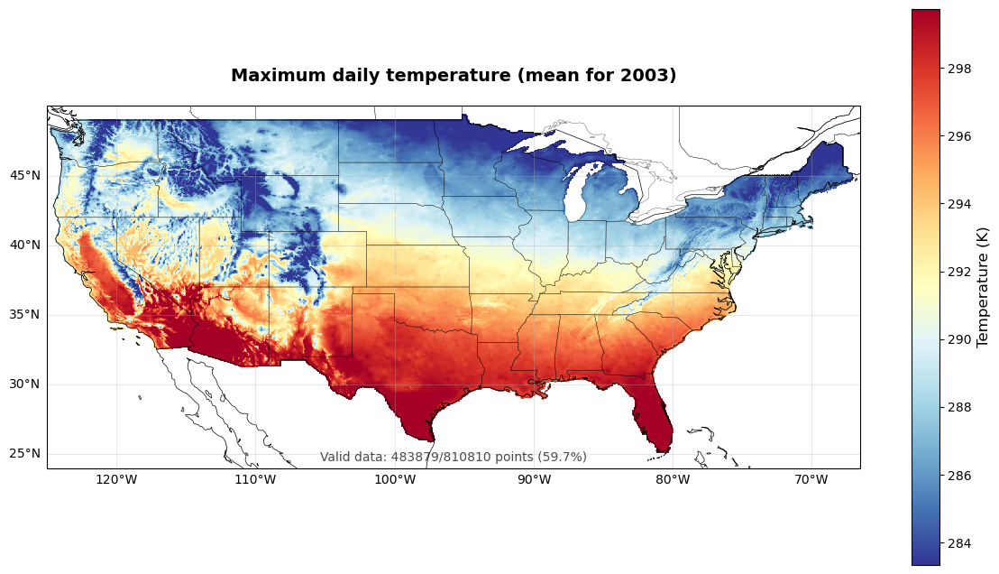


Plotting VPD: Vapor pressure deficit
Analyzing vpd (mean_vapor_pressure_deficit)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: kPa, Scale: 0.01, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 8.740
Masked fill value: 32767
Applied scaling: factor=0.01, offset=0.0
After scaling: 0.000 to 0.087
Plot data range: 0.000 to 0.034
Valid data points: 483879/810810 (59.7%)
Vapor pressure deficit range: 0.004 to 0.016
Using colormap: Reds, range: 0.004 to 0.016


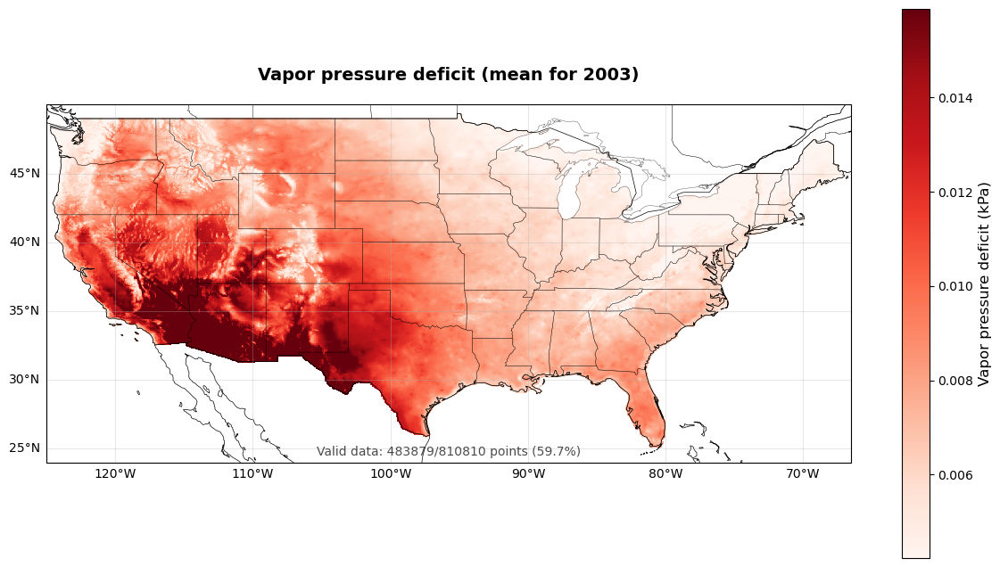


Plotting VS: Wind speed
Analyzing vs (wind_speed)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: m/s, Scale: 0.1, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.200 to 20.700
Masked fill value: 32767
Applied scaling: factor=0.1, offset=0.0
After scaling: 0.020 to 2.070
Plot data range: 0.182 to 0.714
Valid data points: 483879/810810 (59.7%)
Wind speed range: 0.0 to 0.5
Using colormap: plasma, range: 0.000 to 0.499


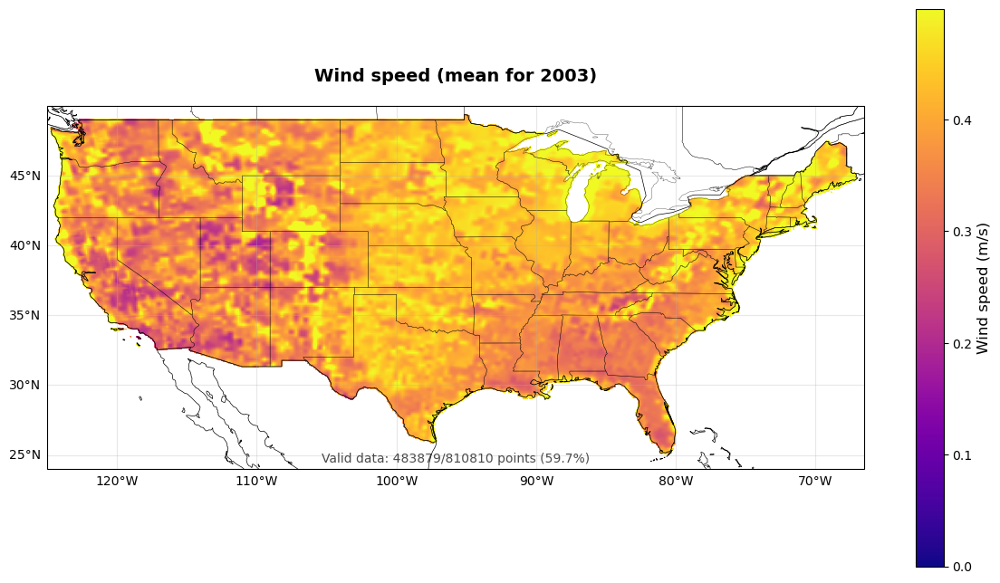

In [19]:
# =============================================================================
# Batch Process
# =============================================================================

# Plot all variables in a loop
variables = ['bi', 'etr', 'fm1000', 'fm100', 'pet', 'pr', 'rmax', 'rmin', 
             'sph', 'srad', 'th', 'tmmn', 'tmmx', 'vpd', 'vs']

for var in variables:
    print(f"\n{'='*50}")
    print(f"Plotting {var.upper()}: {weather_eda.variable_descriptions.get(var, 'Unknown')}")
    print(f"{'='*50}")
    
    fig = weather_eda.plot_spatial_map(var, agg_method='mean')
    if fig:
        plt.show()
    
    # clear mem
    plt.close('all')
    gc.collect()

Analyzing tmmx (air_temperature)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: K, Scale: 0.1, Offset: 220.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 246.800 to 325.500
Masked fill value: 32767
Raw temperature data already in reasonable Kelvin range - skipping scaling
Using raw data: 246.8K to 325.5K
Temperature range: 246.8 to 325.5 K
Plot data range: 271.267 to 306.785
Valid data points: 483879/810810 (59.7%)
Temperature range: 283.3 to 299.7 K
Using colormap: RdYlBu_r, range: 283.344 to 299.733
Analyzing tmmn (air_temperature)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: K, Scale: 0.1, Offset: 210.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 237.700 to 310.100
Masked fill value: 32767
Raw temperature data already in reasonable Kelvin range - skipping scaling
Using raw data: 237.7K to 310.1K
Temperature r

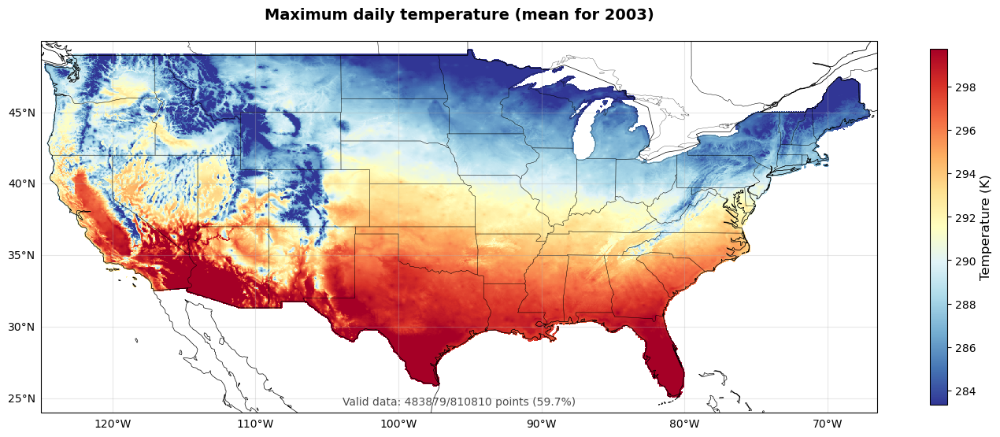

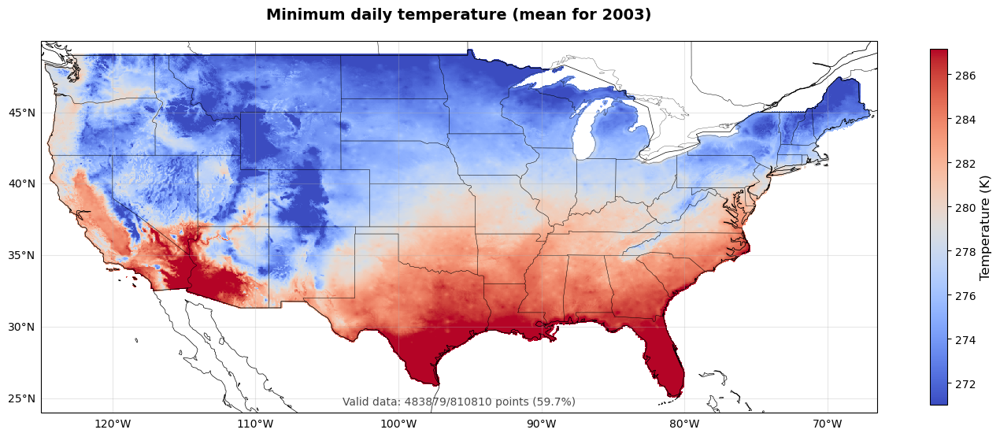

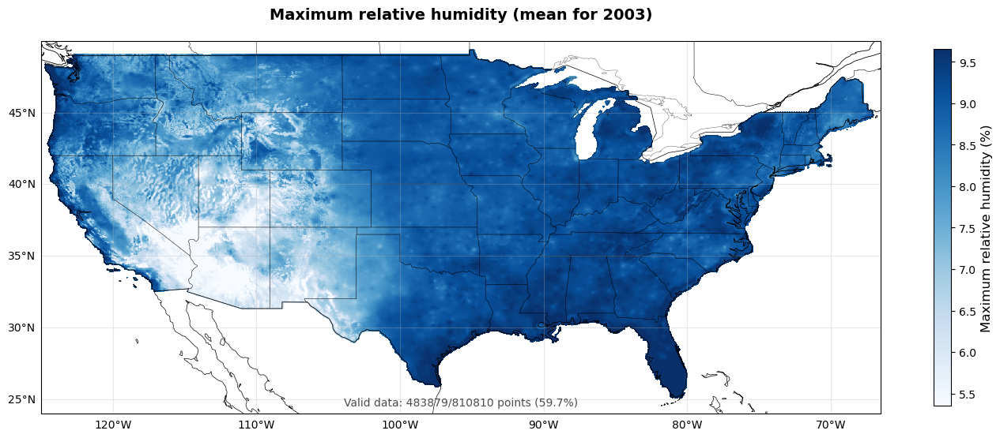

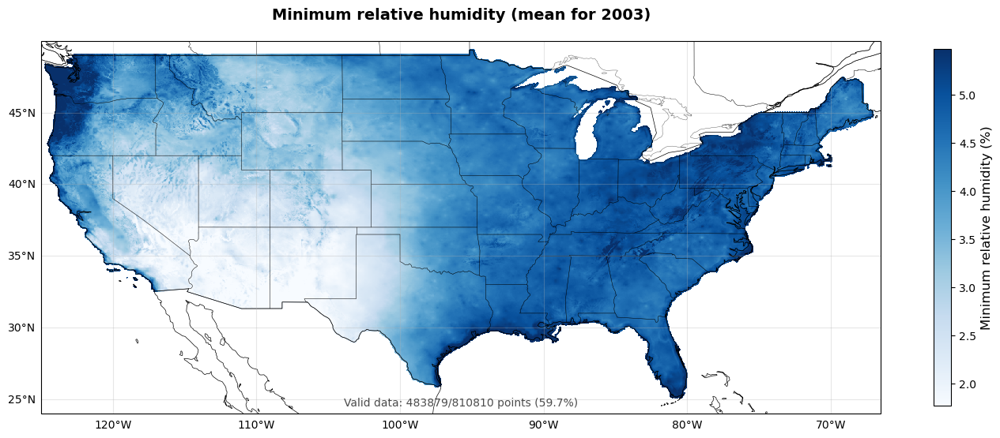

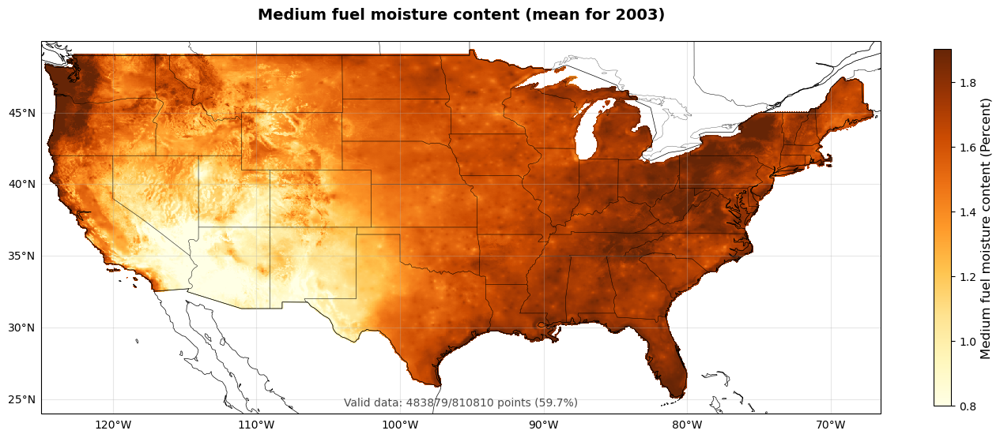

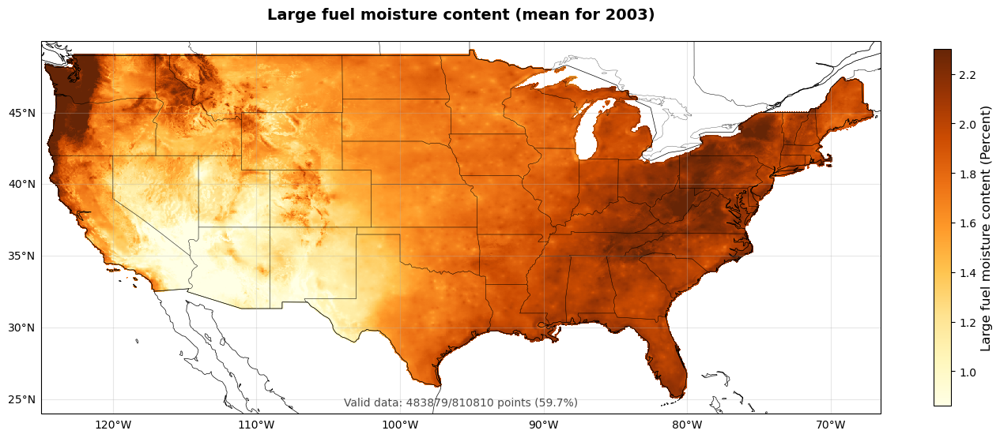

In [20]:
# =============================================================================
# Comparitive 
# =============================================================================

# Compare min vs max temperatures
fig_tmax = weather_eda.plot_spatial_map('tmmx', agg_method='mean', figsize=(14, 6))
fig_tmin = weather_eda.plot_spatial_map('tmmn', agg_method='mean', figsize=(14, 6))

# Compare min vs max humidity
fig_rhmax = weather_eda.plot_spatial_map('rmax', agg_method='mean', figsize=(14, 6))
fig_rhmin = weather_eda.plot_spatial_map('rmin', agg_method='mean', figsize=(14, 6))

# Compare different fuel moisture timeframes
fig_fm100 = weather_eda.plot_spatial_map('fm100', agg_method='mean', figsize=(14, 6))
fig_fm1000 = weather_eda.plot_spatial_map('fm1000', agg_method='mean', figsize=(14, 6))

Analyzing bi (burning_index_g)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Unitless, Scale: 1.0, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 170.000
Masked fill value: 32767
No scaling needed (scale=1.0, offset=0.0)
Plot data range: 0.000 to 157.000
Valid data points: 483879/810810 (59.7%)
Burning index range: 0.000 to 101.000
Using colormap: YlOrRd, range: 0.000 to 101.000
Analyzing bi (burning_index_g)
Grid: 585 x 1386 points
Lat range: 25.07 to 49.40
Lon range: -124.77 to -67.06
Metadata - Units: Unitless, Scale: 1.0, Offset: 0.0
Fill/Missing values: 32767/32767
Raw data shape: (365, 585, 1386)
Raw data range: 0.000 to 170.000
Masked fill value: 32767
No scaling needed (scale=1.0, offset=0.0)
Plot data range: 0.000 to 118.000
Valid data points: 483879/810810 (59.7%)
Burning index range: 0.000 to 91.000
Using colormap: YlOrRd, range: 0.000 to 91.000
Analyzing bi (burning_in

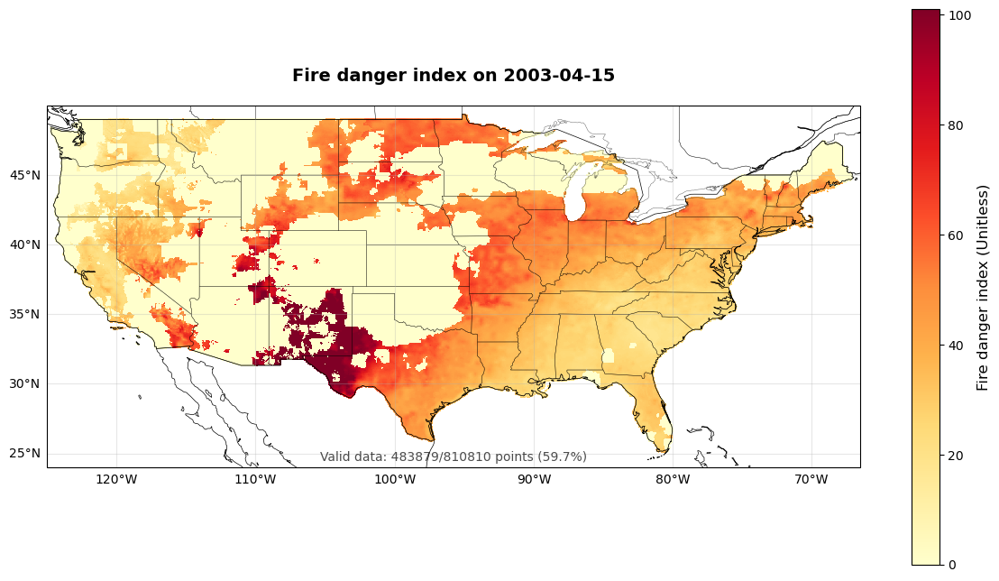

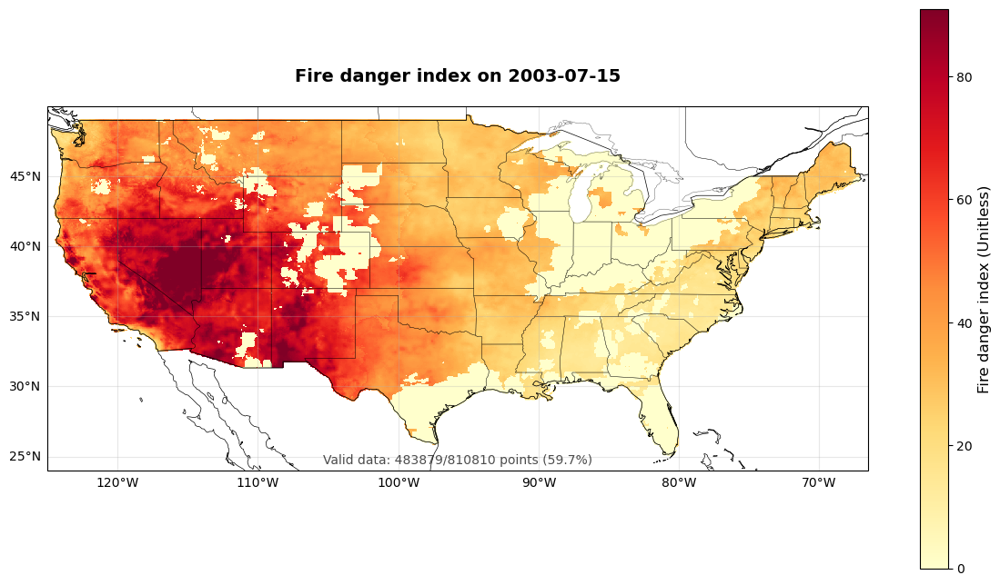

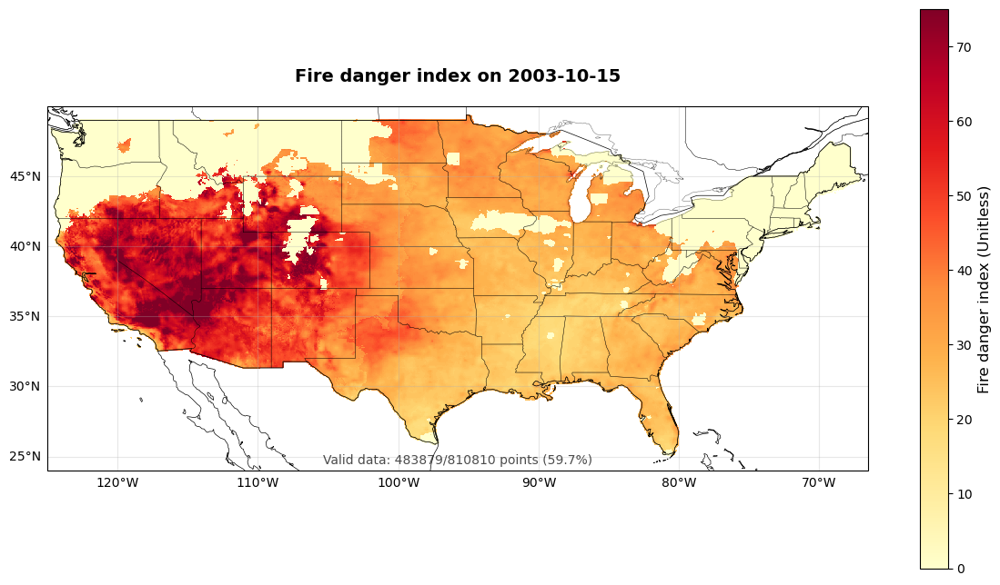

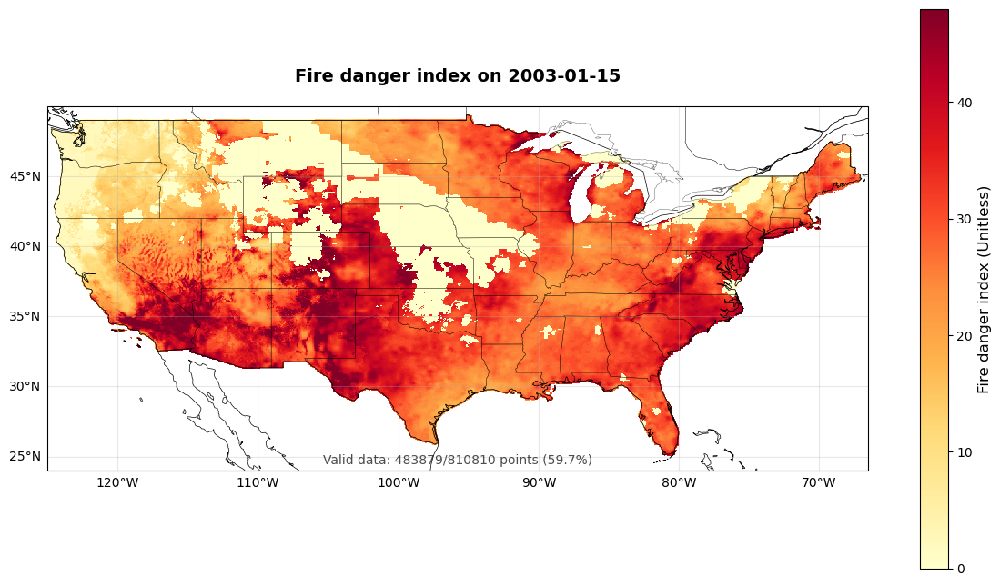

In [21]:
# =============================================================================
# Season Comparison 
# =============================================================================

# Spring conditions (April 15th)
fig_spring = weather_eda.plot_spatial_map('bi', date='2003-04-15')

# Summer conditions (July 15th) 
fig_summer = weather_eda.plot_spatial_map('bi', date='2003-07-15')

# Fall conditions (October 15th)
fig_fall = weather_eda.plot_spatial_map('bi', date='2003-10-15')

# Winter conditions (January 15th)
fig_winter = weather_eda.plot_spatial_map('bi', date='2003-01-15')

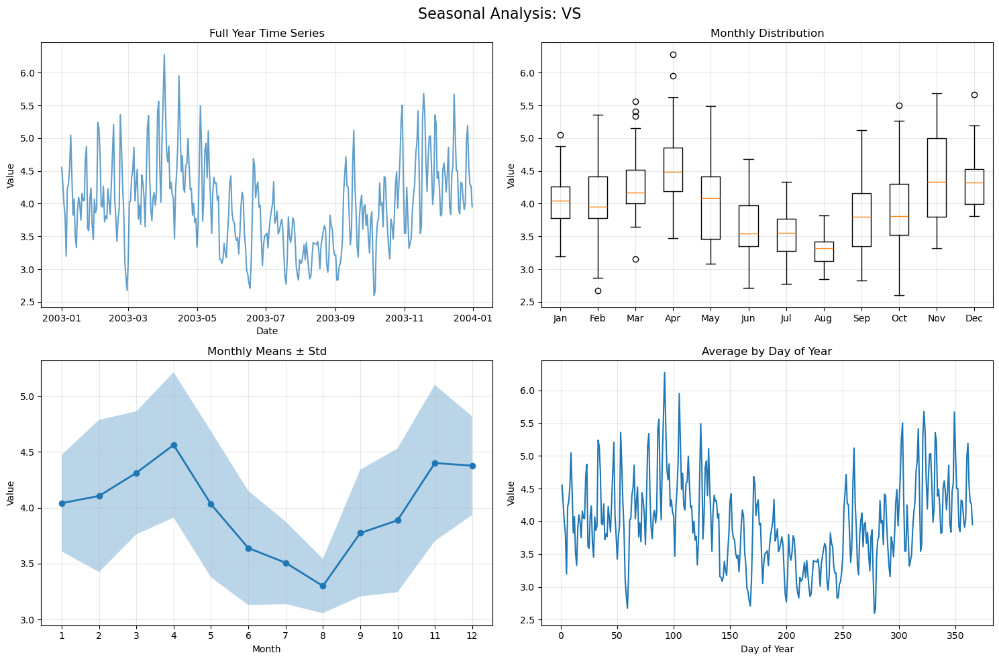

In [30]:
# VS
fig, monthly_stats = weather_eda.seasonal_analysis('vs')
plt.show()

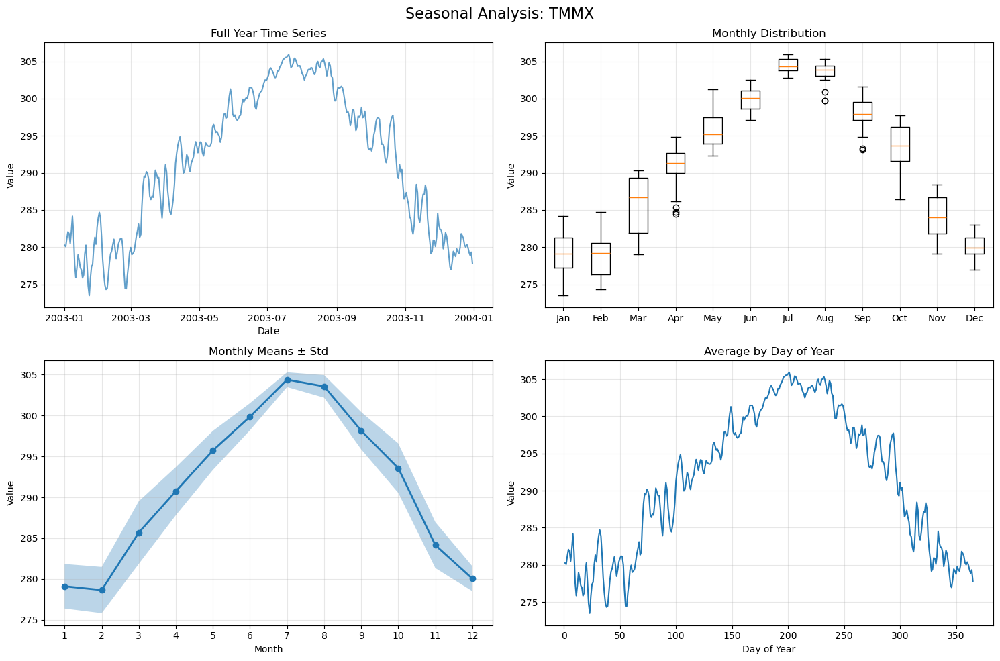

In [31]:
# tmnx
fig, monthly_stats = weather_eda.seasonal_analysis('tmmx')
plt.show()

In [ ]:
t